## 1. Import Library, Load Dataset & Exploration Images from 2 Categories (Cataract and Normal)

In [1]:
# Meng-import library-library yang akan dibutuhkan selama proses eksperimen
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
plt.style.use("seaborn")
import numpy as np
import tensorflow as tf
from PIL import Image
import cv2
from tensorflow import keras
from glob import glob
from tensorflow.keras.preprocessing import image_dataset_from_directory
from keras.optimizers import SGD, Adam, RMSprop, Adadelta, Adagrad, Adamax, Nadam, Ftrl
from keras.layers import BatchNormalization, Flatten, Dropout, GlobalAveragePooling2D, Dense
from tensorflow.keras.models import Sequential
from keras.applications import EfficientNetB7 # Library untuk algoritma EfficientNetB7
from tensorflow.keras import regularizers

In [2]:
# Memanggil semua data gambar dari 2 label gambar yang berbeda di dalam folder Dataset dengan 2 Label (Katarak dan Normal)
cataract_label_image = "../Dataset dengan 2 Label (Katarak dan Normal)/Cataract"
normal_label_image = "../Dataset dengan 2 Label (Katarak dan Normal)/Normal"

In [3]:
"""
Memanggil semua data gambar berdasarkan nama file gambar dengan seluruh format
gambar yang tersedia seperti .png/.jpg/.jpeg, dll, dari kategori/label data gambar mata katarak
"""
# Variabel untuk menampung semua data/nama file gambar dengan label/kategori mata katarak
cataract_images = glob(cataract_label_image + "/*")

# Menampilkan hasil dari variabel "cataract_images" untuk melihat semua data gambar di dalam label/kategori mata katarak
print(cataract_images)

['../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\0_left.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\103_left.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\1062_right.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\1083_left.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\1084_right.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\1102_left.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\1102_right.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\1115_left.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\1126_right.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\112_right.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\1144_left.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\1144_right.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\1164_left.jpg', '../Dataset dengan 2 Label (Katarak 

In [4]:
"""
Memanggil semua data gambar berdasarkan nama file gambar dengan seluruh format
gambar yang tersedia seperti .png/.jpg/.jpeg, dll, dari kategori/label data gambar mata normal
"""

# Variabel untuk menampung semua data/nama file gambar dengan label/kategori mata normal
normal_images = glob(normal_label_image + "/*")

# Menampilkan hasil dari variabel "normal_images" untuk melihat semua data gambar di dalam label/kategori mata normal
print(normal_images)

['../Dataset dengan 2 Label (Katarak dan Normal)/Normal\\1034_left.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Normal\\1034_right.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Normal\\1060_left.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Normal\\1060_right.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Normal\\1253_left.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Normal\\1253_right.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Normal\\2329_left.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Normal\\2329_right.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Normal\\2331_left.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Normal\\2331_right.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Normal\\2332_left.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Normal\\2332_right.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Normal\\2334_left.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Normal\\2

Berdasarkan 2 script diatas saya menggunakan sebuah fungsi yang bernama glob. Fungsi glob merupakan sebuah fungsi yang dapat memanggil seluruh nama file yang memiliki kecocokan pola yang ada di dalam sub-folder data-data tersebut. Fungsi glob biasanya dilakukan pada pemrosesan/eksperimen image processing. Pada kasus 2 script diatas yang merupakan main folder (folder utama) adalah nama folder yang bernama "Dataset dengan 2 Label (Katarak dan Normal)". Di dalam main folder terdapat 2 buah sub-folder dengan nama "Cataract" dan "Normal". Kedua sub-folder tersebut sudah pasti menyimpan data-data gambar yang diwakili oleh nama-nama file dari masing-masing data gambar tersebut yang sudah pasti dibedakan berdasarkan 2 sub-folder yakni Cataract dan Normal.

Sebagai contoh script diatas memiliki nama file 1034_left.jpg dan 1034_right.jpg yang merupakan gambar mata dengan kategori/label Normal dari folder utama dalam eksperimen ini yakni "Dataset dengan 2 Label (Katarak dan Normal)". Nama file 1034_left.jpg dan 1034_right.jpg juga menandakan bahwa kedua gambar ini merupakan gambar mata sepasang (kiri dan kanan) dengan kategori mata yang normal. Hal ini juga berlakukan untuk setiap file yang ada di dalam label Normal dan Cataract yang berada dalam script diatas kategori mata Normal.

In [5]:
# Melihat total data dari kategori/label mata katarak dan mata normal
print("Sepuluh Nama File Teratas dari Data Gambar dengan Label/Kategori Mata Katarak: \n", cataract_images[0:10], "\n")
print("Total Data pada Label Gambar Mata Katarak: ", len(cataract_images), "\n")

print("Sepuluh Nama File Teratas dari Data Gambar dengan Label/Kategori Mata Normal: \n", normal_images[0:10], "\n")
print("Total Data pada Label Gambar Mata Normal: ", len(normal_images), "\n")

Sepuluh Nama File Teratas dari Data Gambar dengan Label/Kategori Mata Katarak: 
 ['../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\0_left.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\103_left.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\1062_right.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\1083_left.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\1084_right.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\1102_left.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\1102_right.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\1115_left.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\1126_right.jpg', '../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\\112_right.jpg'] 

Total Data pada Label Gambar Mata Katarak:  1038 

Sepuluh Nama File Teratas dari Data Gambar dengan Label/Kategori Mata Normal: 
 ['../Dataset dengan 2 Label (Katarak dan Norm

In [6]:
# Mengecek resolusi/dimensi dari lima gambar dengan label/kategori mata Normal

print("--------------------Resolusi/Dimensi dari Kelima Gambar dengan Label Mata Normal--------------------")

# Gambar mata dengan label Normal dengan urutan file ke-1.074 (List gambar paling terakhir dari label mata Normal)
normal_eye_1074 = Image.open(str(normal_images[1073]))
width, height = normal_eye_1074.size # .size merupakan sebuah function untuk memanggil ukuran pada suatu gambar
print("Dimensi Ukuran Gambar Mata Normal dengan List/Urutan ke-1.074 :", str(width) + "x" + str(height))

# Gambar mata dengan label Normal dengan urutan file ke-85
normal_eye_85 = Image.open(str(normal_images[84]))
width, height = normal_eye_85.size
print("Dimensi Ukuran Gambar Mata Normal dengan List/Urutan File ke-85 :", str(width) + "x" + str(height))

# Gambar mata dengan label Normal dengan urutan file ke-148
normal_eye_148 = Image.open(str(normal_images[147]))
width, height = normal_eye_148.size
print("Dimensi Ukuran Gambar Mata Normal dengan List/Urutan File ke-148 :", str(width) + "x" + str(height))

# Gambar mata dengan label Normal dengan urutan file ke-872
normal_eye_872 = Image.open(str(normal_images[871]))
width, height = normal_eye_872.size
print("Dimensi Ukuran Gambar Mata Normal dengan List/Urutan File ke-872 :", str(width) + "x" + str(height))

# Gambar mata dengan label Normal dengan urutan file ke-1001
normal_eye_1001 = Image.open(str(normal_images[1000]))
width, height = normal_eye_1001.size
print("Dimensi Ukuran Gambar Mata Normal dengan List/Urutan File ke-1001 :", str(width) + "x" + str(height))

--------------------Resolusi/Dimensi dari Kelima Gambar dengan Label Mata Normal--------------------
Dimensi Ukuran Gambar Mata Normal dengan List/Urutan ke-1.074 : 512x512
Dimensi Ukuran Gambar Mata Normal dengan List/Urutan File ke-85 : 512x512
Dimensi Ukuran Gambar Mata Normal dengan List/Urutan File ke-148 : 512x512
Dimensi Ukuran Gambar Mata Normal dengan List/Urutan File ke-872 : 512x512
Dimensi Ukuran Gambar Mata Normal dengan List/Urutan File ke-1001 : 512x512


Hasil output diatas menunjukkan bahwa kelima resolusi/dimensi gambar dari mata berlabel normal memiliki panjang sebesar 512 piksel dan lebar sebesar 512 piksel. Artinya adalah kelima gambar tersebut sudah memiliki ukuran yang sama merata antar gambar satu sampai gambar kelima yang saya pilih secara acak tetapi walaupun begitu saya tidak dapat memastikan apakah semua gambar memiliki panjang dan lebar yang sama (512 x 512) atau diantara 1.074 total data dari gambar mata berlabel normal terdapat beberapa gambar yang memiliki dimensi yang berbeda dari 512 x 512. Maka dari itu saya nantinya akan membuat ukuran gambar menjadi sama rata di tahapan augmentasi gambar di dalam tahapan preprocessing.

Selanjutnya saya akan melakukan hal yang sama yaitu mengecek apakah kelima gambar dari mata yang memiliki penyakit katarak juga memiliki ukuran dimensi yang sama dengan mata berlabel normal atau tidak.

In [7]:
# Mengecek resolusi/dimensi dari lima gambar dengan label/kategori mata Katarak

print("--------------------Resolusi/Dimensi dari Kelima Gambar dengan Label Mata Katarak--------------------")

# Gambar mata dengan label Katarak dengan urutan file ke-651
cataract_eye_651 = Image.open(str(cataract_images[650]))
width, height = cataract_eye_651.size # .size merupakan sebuah function untuk memanggil ukuran pada suatu gambar
print("Dimensi Ukuran Gambar Mata Katarak dengan List/Urutan ke-651 :", str(width) + "x" + str(height))

# Gambar mata dengan label Katarak dengan urutan file ke-85
cataract_eye_85 = Image.open(str(cataract_images[84]))
width, height = cataract_eye_85.size
print("Dimensi Ukuran Gambar Mata Katarak dengan List/Urutan File ke-85 :", str(width) + "x" + str(height))

# Gambar mata dengan label Katarak dengan urutan file ke-1038 (List gambar paling terakhir dari label mata katarak)
cataract_eye_1038 = Image.open(str(cataract_images[1037]))
width, height = cataract_eye_1038.size
print("Dimensi Ukuran Gambar Mata Katarak dengan List/Urutan File ke-1038 :", str(width) + "x" + str(height))

# Gambar mata dengan label Katarak dengan urutan file ke-247
cataract_eye_247 = Image.open(str(cataract_images[246]))
width, height = cataract_eye_247.size
print("Dimensi Ukuran Gambar Mata Katarak dengan List/Urutan File ke-247 :", str(width) + "x" + str(height))

# Gambar mata dengan label Katarak dengan urutan file ke-93
cataract_eye_93 = Image.open(str(cataract_images[92]))
width, height = cataract_eye_93.size
print("Dimensi Ukuran Gambar Mata Katarak dengan List/Urutan File ke-93 :", str(width) + "x" + str(height))

--------------------Resolusi/Dimensi dari Kelima Gambar dengan Label Mata Katarak--------------------
Dimensi Ukuran Gambar Mata Katarak dengan List/Urutan ke-651 : 256x256
Dimensi Ukuran Gambar Mata Katarak dengan List/Urutan File ke-85 : 512x512
Dimensi Ukuran Gambar Mata Katarak dengan List/Urutan File ke-1038 : 256x256
Dimensi Ukuran Gambar Mata Katarak dengan List/Urutan File ke-247 : 512x512
Dimensi Ukuran Gambar Mata Katarak dengan List/Urutan File ke-93 : 512x512


Hasil diatas menunjukkan bahwa keempat resolusi/dimensi dari gambar mata berpenyakit katarak memiliki ukuran dimensi yang sama dengan dimensi yang telah didapatkan pada kelima gambar mata normal yakni panjang sebesar 512 piksel dan lebar sebesar 512 piksel. Tetapi ada perbedaan yaitu dimensi pada gambar katarak dengan urutan (list) ke-651 dan 1.038 pada sub-folder Cataract yang memiliki dimensi gambar yakni 256x256.

Walaupun begitu ketiga gambar dari mata berlabel/berkategori katarak sudah memiliki ukuran yang sama merata yang saya pilih secara acak tetapi saya tidak dapat memastikan apakah semua gambar dari label katarak ini memiliki panjang dan lebar yang sama (512 x 512) atau apakah diantara 1.038 total data dari gambar mata berlabel katarak terdapat beberapa gambar yang memiliki dimensi yang berbeda/diluar dari 512 x 512 (seperti pada contoh gambar mata katarak dengan list ke-651 dan 1.038). Maka dari itu untuk membuat ukuran gambar, baik dengan label data gambar katarak/normal, menjadi sama rata akan dilakukan di tahapan augmentasi gambar yang ada di dalam tahapan preprocessing data gambar menggunakan fungsi resize untuk image data khususnya pada eksperimen image processing.

## 2. Displaying Some Another Image Data from Cataract and Normal Labels

### 2.1. Showing One Image per List from Cataract and Normal Eye's Labels

#### 2.1.1. Six Pictures of Cataract Eye Label

../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\1102_right.jpg 



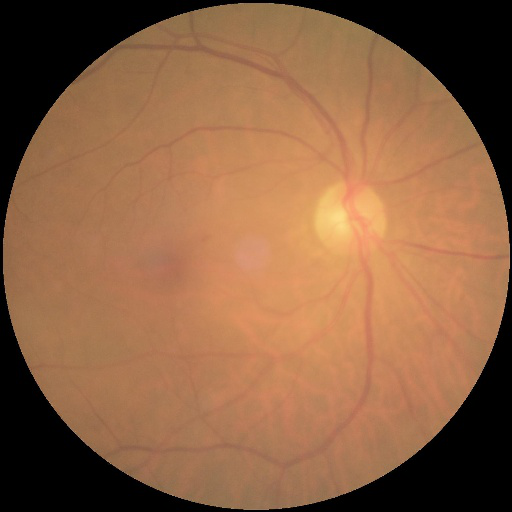

In [8]:
# Menampilkan gambar dengan urutan ketujuh dari indeks gambar pada label mata katarak
cataract_image7 = list(cataract_images)
print(cataract_image7[6], "\n")

# Membuka gambar dari list/urutan pada indeks keenam atau dengan kata lain melihat gambar ketuju dari mata katarak
Image.open(str(cataract_image7[6]))

../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\2132_left.jpg 



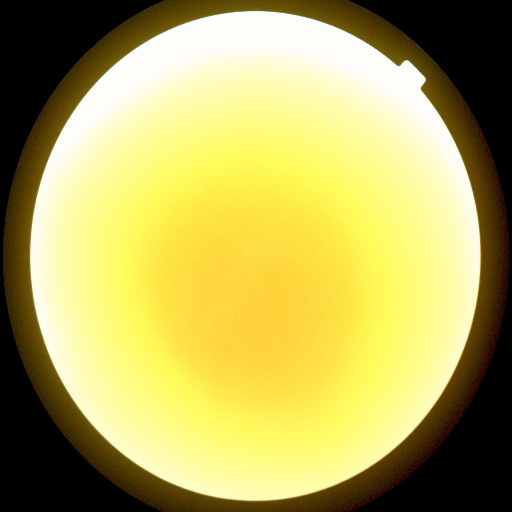

In [9]:
# Menampilkan gambar mata katarak dengan urutan gambar ke-89 berdasarkan urutan (list) data di dalam label mata katarak
cataract_image89 = list(cataract_images)
print(cataract_image89[88], "\n")

# Membuka gambar dari list ke-89 atau dengan kata lain melihat gambar ke-89 dari label/kategori mata katarak
Image.open(str(cataract_image89[88]))

../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\2074_right.jpg 



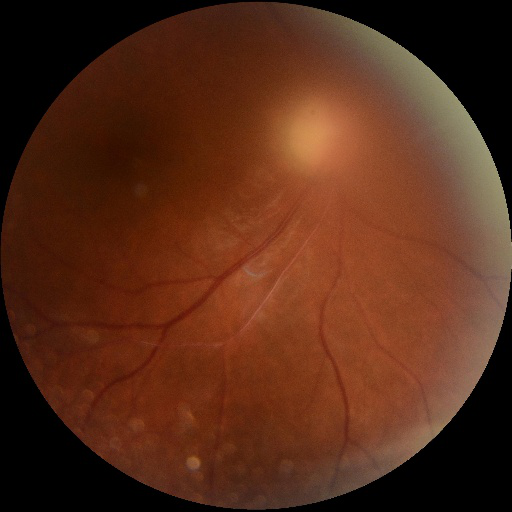

In [10]:
# Menampilkan gambar mata katarak dengan urutan gambar ke-36 berdasarkan urutan (list) data di dalam label mata katarak
cataract_image36 = list(cataract_images)
print(cataract_image36[35], "\n")

# Membuka gambar dari list ke-36 atau dengan kata lain melihat gambar ke-36 dari label/kategori mata katarak
Image.open(str(cataract_image36[35]))

../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\_348_8120738.jpg 



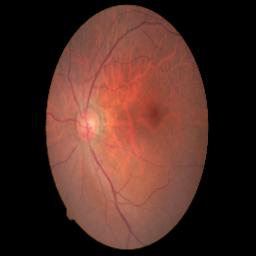

In [11]:
# Menampilkan gambar mata katarak dengan urutan gambar ke-838 berdasarkan urutan (list) data di dalam label mata katarak
cataract_image838 = list(cataract_images)
print(cataract_image838[837], "\n")

# Membuka gambar dari list ke-838 atau dengan kata lain melihat gambar ke-838 dari label/kategori mata katarak
Image.open(str(cataract_image838[837]))

../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\_241_7236668.jpg 



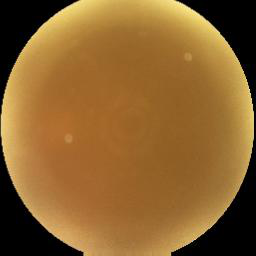

In [12]:
# Menampilkan gambar mata katarak dengan urutan gambar ke-651 berdasarkan urutan (list) data di dalam label mata katarak
cataract_image651 = list(cataract_images)
print(cataract_image651[650], "\n")

# Membuka gambar dari list ke-651 atau dengan kata lain melihat gambar ke-651 dari label/kategori mata katarak
Image.open(str(cataract_image651[650]))

../Dataset dengan 2 Label (Katarak dan Normal)/Cataract\_9_1244013.jpg 



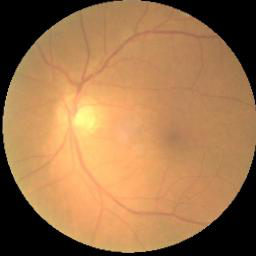

In [13]:
# Menampilkan gambar mata katarak dengan urutan gambar ke-1.038 berdasarkan urutan (list) data di dalam label mata katarak
cataract_image1038 = list(cataract_images)
print(cataract_image1038[1037], "\n")

# Membuka gambar dari list ke-1.038 atau dengan kata lain melihat gambar ke-1.038 dari label/kategori mata katarak
Image.open(str(cataract_image1038[1037]))

#### 2.1.2. Six Pictures of Normal Eye Label

../Dataset dengan 2 Label (Katarak dan Normal)/Normal\3425_left.jpg 



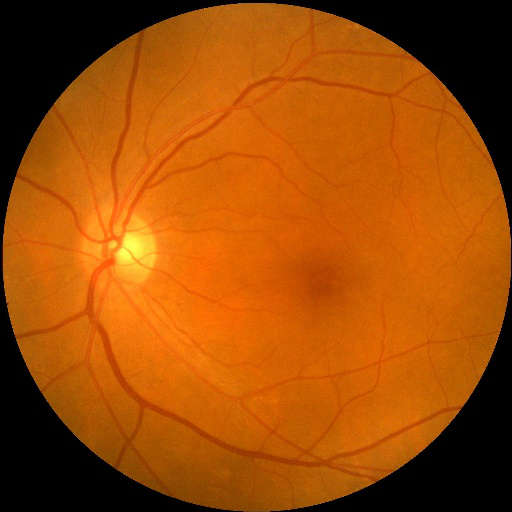

In [14]:
# Menampilkan gambar berlabel normal dengan urutan gambar ke-1.033 berdasarkan urutan (list) data di dalam label mata normal
normal_image1033 = list(normal_images)
print(normal_image1033[1032], "\n")

# Membuka gambar dari list ke-1.033 atau dengan kata lain melihat gambar ke-1.033 dari label/kategori mata normal
Image.open(str(normal_image1033[1032]))

../Dataset dengan 2 Label (Katarak dan Normal)/Normal\3407_right.jpg 



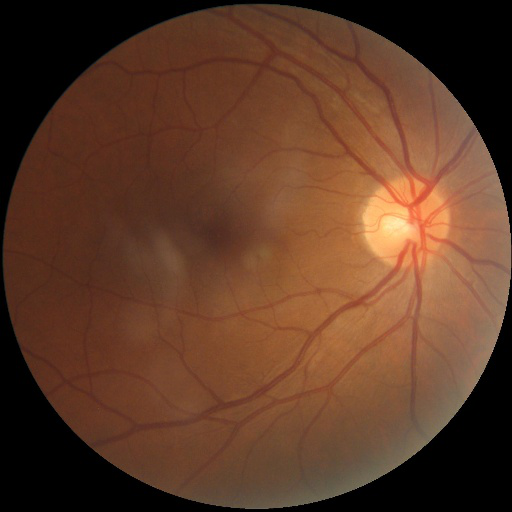

In [15]:
# Membuat variabel "normal_image1008" agar bisa melihat gambar mata normal yang ada di list/urutan ke-1008
normal_image1008 = list(normal_images)
print(normal_image1008[1007], "\n")

# Menampilkan gambar mata dari label normal berdasarkan indeks list/urutan gambar ke-1008
Image.open(str(normal_image1008[1007]))

../Dataset dengan 2 Label (Katarak dan Normal)/Normal\2616_left.jpg 



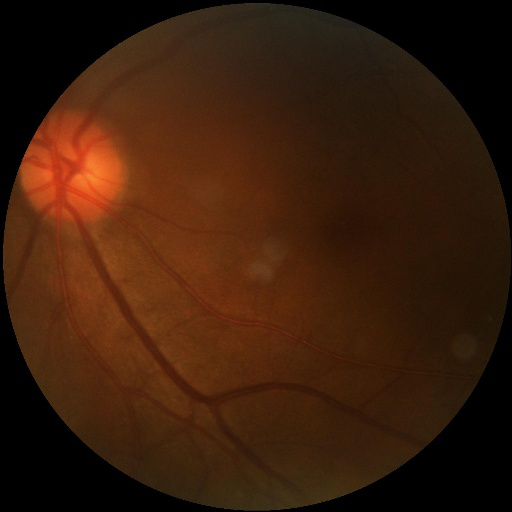

In [16]:
# Membuat variabel baru yang bernama "normal_image281" agar bisa melihat gambar mata berlabel normal yang ada di urutan ke-281
normal_image281 = list(normal_images)
print(normal_image281[280], "\n")

# Menampilkan gambar mata dengan label normal berdasarkan indeks gambar di list/urutan ke-281
Image.open(str(normal_image281[280]))

../Dataset dengan 2 Label (Katarak dan Normal)/Normal\2702_left.jpg 



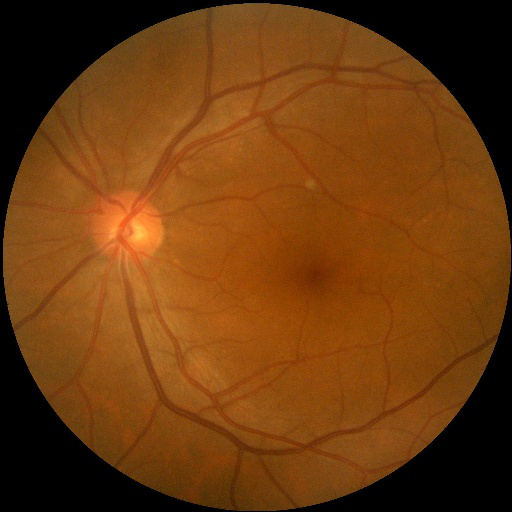

In [17]:
"""
Membuat variabel baru untuk menampung list gambar dengan urutan 368 dari label bermata normal
serta menampilkan nama folder, sub-folder dan nama file dari indeks list gambar ke-368
"""
normal_image368 = list(normal_images)
print(normal_image368[367], "\n")

# Menampilkan gambar mata berdasarkan label normal dari indeks gambar denngan list/urutan ke-368
Image.open(str(normal_image368[367]))

../Dataset dengan 2 Label (Katarak dan Normal)/Normal\3145_left.jpg 



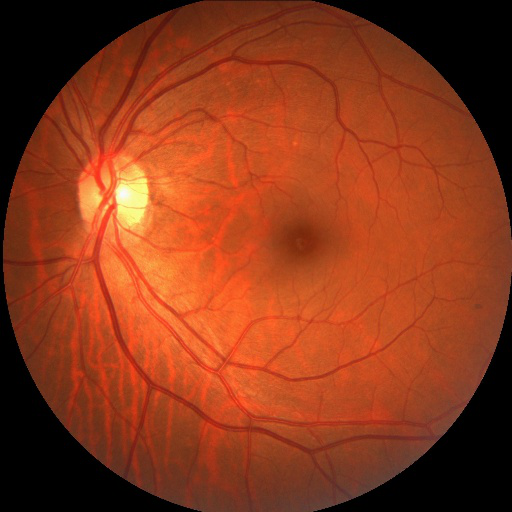

In [18]:
"""
Membuat variabel untuk menampung list gambar dengan urutan 773 dari label bermata normal
serta menampilkan nama folder, sub-folder dan nama file dari indeks list gambar ke-773
"""
normal_image773 = list(normal_images)
print(normal_image773[772], "\n") # Menampilkan output berupa nama folder utama, sub-folder (Normal) dan nama file dari gambar ke-773

# Menampilkan gambar mata dengan label normal berdasarkan indeks gambar di list/urutan ke-773
Image.open(str(normal_image773[772]))

../Dataset dengan 2 Label (Katarak dan Normal)/Normal\2367_right.jpg 



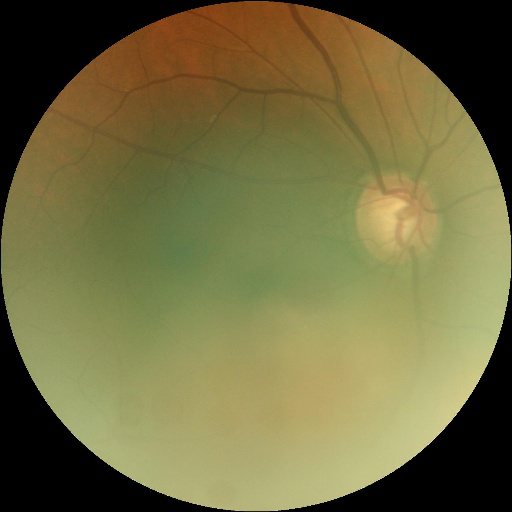

In [19]:
"""
Membuat variabel untuk menampung list gambar ke-46 dari label bermata normal
serta menampilkan nama folder, sub-folder dan nama file dari indeks list gambar ke-46
"""
normal_image46 = list(normal_images)
print(normal_image46[45], "\n") # Menampilkan output berupa nama folder utama, sub-folder (Normal) dan nama file dari gambar ke-46

# Menampilkan gambar mata dengan label normal berdasarkan indeks gambar di list/urutan ke-46
Image.open(str(normal_image46[45]))

### 2.2. Displaying 20 Eye Images Data from Each Labels, Cataract and Normal

#### 2.2.1. Display 20 Images from Cataract Eye's Label

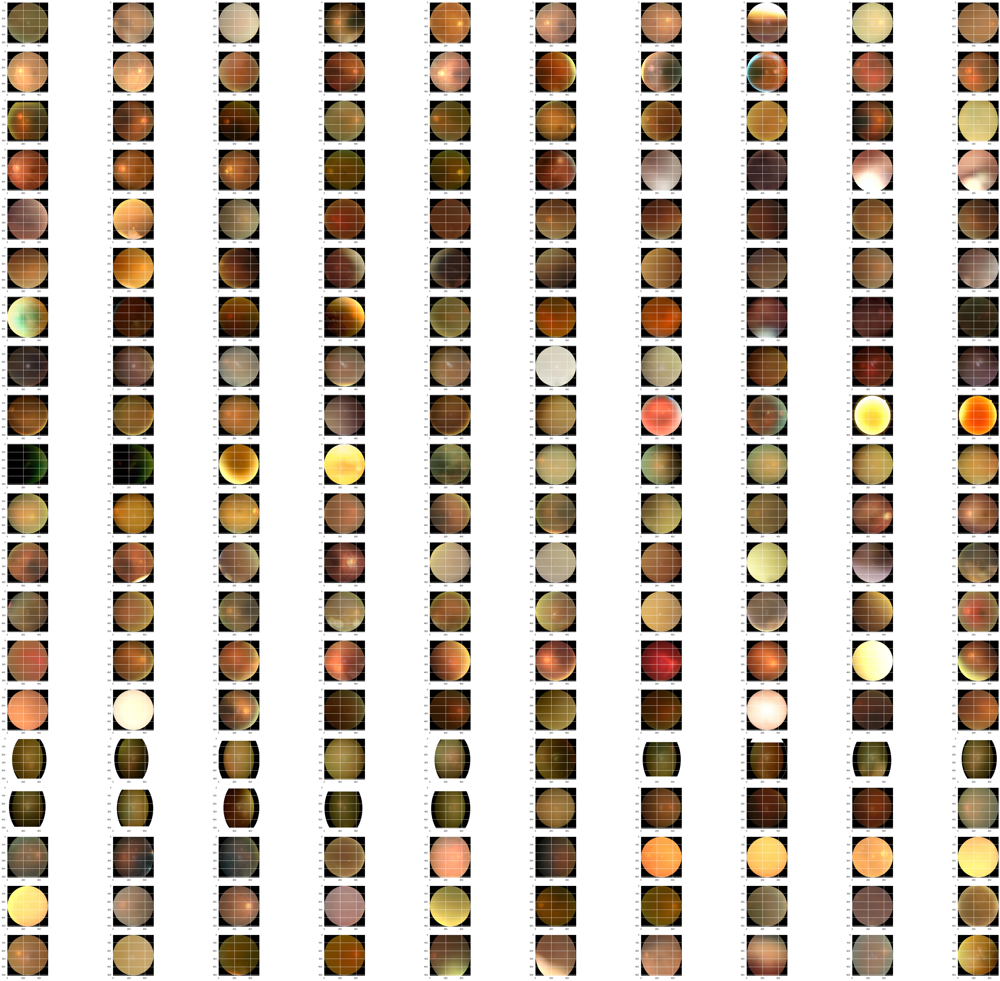

In [20]:
# Menampilkan 20 gambar mata berpenyakit katarak yang akan ditampung ke dalam 10 kolom berbeda
fig = plt.figure(figsize=(80, 77))

rows = 20 # Bertujuan untuk menampilkan 20 baris gambar mata dengan label katarak yang nantinya akan disesuaikan oleh kolom
cols = 10 # Bertujuan untuk memasukkan/menampung data gambar mata dengan label katarak ke 10 kolom berbeda

# Melakukan proses perulangan untuk menampilkan gambar sebanyak 20 baris yang akan ditampung/diisi ke dalam 10 kolom
for cataract_images20 in range(0, rows * cols):
    fig.add_subplot(rows, cols, cataract_images20 + 1)
    cataract_image_label = plt.imread(cataract_images[cataract_images20])
    plt.imshow(cataract_image_label)
    
plt.show()

#### 2.2.2. Display 20 Images from Normal Eye's Label

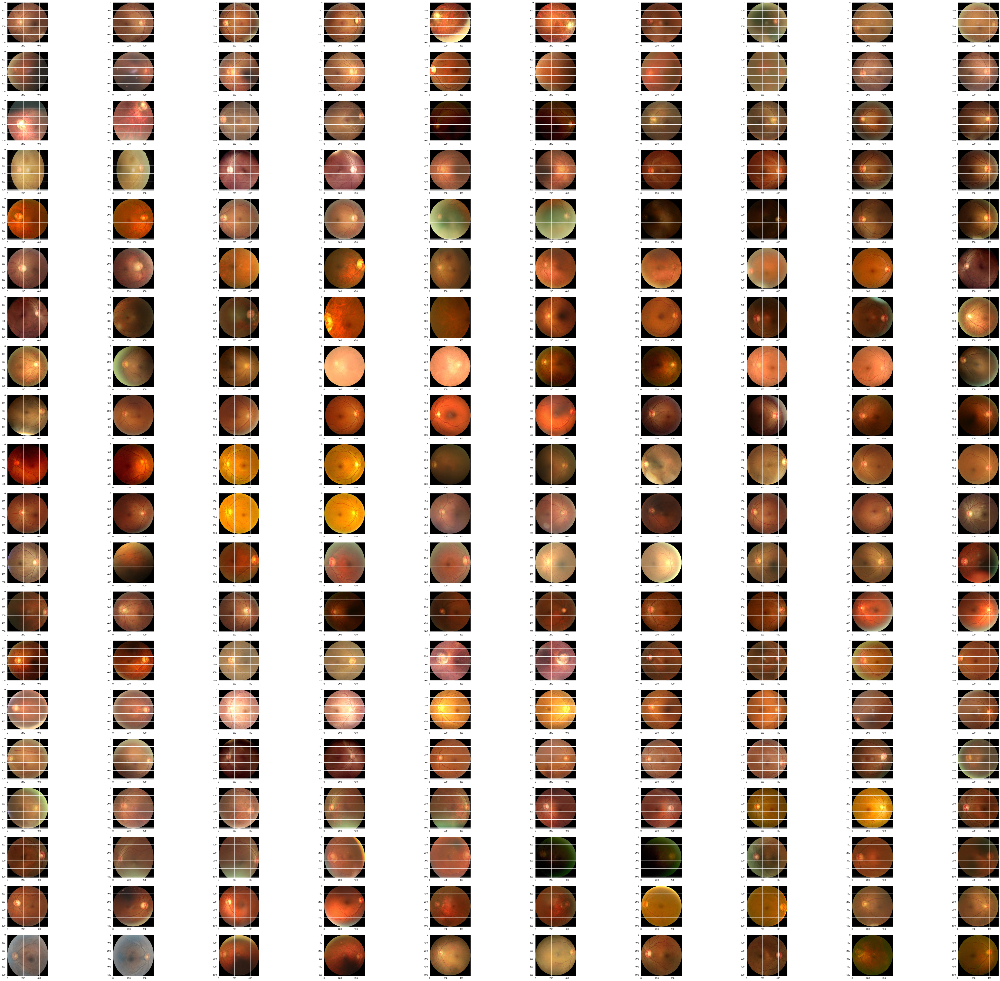

In [21]:
# Menampilkan 20 gambar mata berlabel normal yang akan ditampung ke dalam 10 kolom berbeda
fig = plt.figure(figsize=(80, 77))

rows = 20 # Bertujuan untuk menampilkan 20 baris gambar mata dengan label normal yang nantinya akan disesuaikan oleh kolom
cols = 10 # Bertujuan untuk memasukkan/menampung data gambar mata dengan label normal ke 10 kolom berbeda

# Melakukan proses perulangan untuk menampilkan gambar sebanyak 20 baris yang akan ditampung/diisi ke dalam 10 kolom
for normal_images20 in range(0, rows * cols):
    fig.add_subplot(rows, cols, normal_images20 + 1)
    normal_image_label = plt.imread(normal_images[normal_images20])
    plt.imshow(normal_image_label)
    
plt.show()

Perbedaan yang berhasil saya dapatkan antara gambar mata berlabel katarak dengan gambar mata berlabel normal adalah ketika gambar mata belabel katarak terdapat noda/tanda bercak putih disekitar bola mata dan pewarnaan dari masing-masing gambar pada label/kategori katarak tidak secerah gambar mata di label atau kategori mata normal. Sedangkan di dalam gambar mata normal tidak terdapat bercak atau tanda putih disekitaran mata dan pewarnaan gambar matanya cerah, tidak seperti gambar mata yang memliki penyakit/berlabel katarak.

## 3. Image Data Preprocessing

In [24]:
"""
Membuat 2 bagian generator (training dan testing generator) untuk menampung hasil pemisahan data menjadi 2 bagian
dengan 2 label data gambar yaitu data training untuk label mata katarak dan normal,
lalu kemudian data testing untuk label gambar mata katarak dan label gambar mata normal
berdasarkan main folder yang menampung kedua folder tersebut yaitu "Dataset dengan 2 Label (Katarak dan Normal)"
"""
training_generator = image_dataset_from_directory("../Dataset dengan 2 Label (Katarak dan Normal)",
                                                  image_size=(150, 150),
                                                  subset="training",
                                                  validation_split=0.3,
                                                  labels="inferred",
                                                  shuffle=True,
                                                  label_mode="int",
                                                  color_mode="rgb",
                                                  seed=24,
                                                  batch_size=8)

print()

testing_generator = image_dataset_from_directory("../Dataset dengan 2 Label (Katarak dan Normal)",
                                                  image_size=(150, 150),
                                                  subset="validation",
                                                  validation_split=0.3,
                                                  labels="inferred",
                                                  shuffle=True,
                                                  label_mode="int",
                                                  color_mode="rgb",
                                                  seed=24,
                                                  batch_size=8)

Found 2112 files belonging to 2 classes.
Using 1479 files for training.

Found 2112 files belonging to 2 classes.
Using 633 files for validation.


Berdasarkan hasil output diatas telah diketahui bahwa dalam pengujian kali ini saya akan mengklasifikasikan gambar berdasarkan label/kelas/kategori gambar seperti apakah gambar tersebut teridentifikasi/terklasifikasikan secara tepat atau tidak. Misalkan jika input data adalah gambar mata berlabel katarak maka apakah sistem akan mengklasifikasikan sebagai gambar mata berlabel katarak atau normal. Jika diklasifikasikan dengan normal maka model tersebut tidak tepat dalam mengklasifikasikan data tersebut tetapi jika diklasifikasikan sebagai katarak maka algoritma yang dibuat berhasil dan sukses dalam mengklasifikasikan gambar secara tepat.

Sesuai dengan permasalahan tersebut, hasil output diatas saya telah berhasil membagi keutuhan data dari main folder yang didalamnya terdapat sub-folder dari kedua label gambar (katarak dan normal) dan masing-masing label telah dipisahkan dengan data yang berbeda yaitu data training dan data testing.

Data training memiliki jumlah data sebanyak 1.479 data gambar yang nantinya akan digunakan untuk melatih algoritma EfficientNetB7 dengan parameter algoritma tersebut sedangkan data testing menggunakan data sebanyak 633 gambar yang bertujuan untuk menguji algoritma EfficientNetB7 yang telah mempelajari/dilatih dengan data training terhadap data baru (dalam hal ini 633 data gambar merupakan data baru karena tidak diikutsertakan dalam proses pelatihan dengan algoritma EfficientNetB7).

Selain itu, berdasarkan dari script diatas terdapat beberapa parameter untuk melakukan proses processing data gambar yang dilakukan pada eksperimen kali ini dan berikut adalah penjelasan dari beberapa parameter diatas:

1. image_dataset_from_directory berfungsi untuk memanggil/menghasilkan file data gambar dalam direktori folder utama yang menghasilkan kumpulan gambar dari sub-direktori atau direktori kelas yang merupakan nama sub-direktori. Untuk kasus pada eksperimen kali ini direktori folder utamanya adalah Dataset dengan 2 Label (Katarak dan Normal) dan sub-direktori/folder turunan dari folder utama adalah nama label pada eksperimen ini yaitu katarak dan normal.
2. image_size bertujuan untuk mengubah (resize) piksel gambar yang terdiri dari lebar gambar (width) dan tinggi gambar (height) yang akan digunakan pada eksperimen kali ini. Melakukan perubahan dimensi gambar juga bertujuan agar seluruh gambar memiliki nilai piksel (width dan height) yang sama rata karena kenyataannya beberapa gambar di dalam label katarak dan normal memiliki nilai piksel yang berbeda. Dimensi gambar yang akan digunakan pada eksperimen ini yaitu 100 x 100
3. subset merupakan label/identitas dari gambar yang terdiri dari "training" dan "validation". Subset digunakan ketika nilai dari validation_split digunakan juga.
4. validation_split bertujuan untuk membagi jumlah data dalam proses augmentasi gambar. Pada eksperimen kali ini nilai dari validasinya adalah 0.3 atau 30%. Berarti 30% untuk memvalidasi/menguji data sedangkan 70% untuk melatih data dengan algoritma EfficientNetB7 yang merupakan algoritma eksperimen.
5. label_mode bertujuan untuk menjelaskan dari proses pengkodean dari suatu label gambar. Opsi yang digunakan pada eksperimen ini adalah int yang itu berarti label gambar (katarak atau normal) akan dikodekan menjadi bilangan bulat (misalkan 0 dan 1 atau 1 dan 2) serta nilai loss yang akan digunakan untuk menyusun layer dari algoritma EfficientNetB7 adalah sparse_categorical_crossentropy.
6. labels="inferred" merupakan label yang dihasilkan dari sub-direktori folder atau folder turunan dari folder utama atau daftar/tupel label bilangan bulat dengan ukuran yang sama dengan jumlah gambar dalam label direktori. Dalam hal ini sub-direktorinya adalah katarak dan normal.
7. shuffle bertujuan untuk mengacak/membuat susunan data gambar disetiap masing-masing label (katarak dan normal) akan teracak secara random.
8. batch_size merupakan ukuran dari kumpulan data gambar yang ada di dalam direktori. Nilai batch size yang saya gunakan pada eksperimen ini adalah 8 yang itu berarti setiap pelatihan dari algoritma EfficientNetB7 akan menggunakan data sebanyak 1.479 dan nantinya 1.479 data tersebut akan dibagi dan dikelompokkan ke dalam 8 kumpulan data yang berbeda-beda.
9. class_names merupakan parameter yang berfungsi untuk mengontrol urutan kategori/kelas secara eksplisit dan harus cocok dengan penamaan yang ada di sub-direktori folder.

Referensi:

- https://www.tensorflow.org/api_docs/python/tf/keras/utils/image_dataset_from_directory

- https://keras.io/api/data_loading/image/#load_img-function

- https://github.com/HillidatulIlmi/EDA-and-Deep-Learning-CNN-Fruit-Classification-Predictions/blob/main/EDA_and_CNN_Fruit_Classification_Predictions.ipynb

In [25]:
# Melihat nama label/kategori gambar yang digunakan dalam eksperimen ini, baik dari training generator atau testing generator
label_images_train = training_generator.class_names
print(label_images_train)

label_images_test = testing_generator.class_names
print(label_images_test)

['Cataract', 'Normal']
['Cataract', 'Normal']


Hasil diatas dapat diketahui bahwa masing-masing label, baik label dari data training dan data testing sudah terdapat 2 label gambar yaitu katarak dan normal. Hal itu dikarenakan kedua label ini harus dilatih dan diuji agar algoritma EfficientNetB7 dapat mengklasifikasikan data gambar secara tepat dan akurat berdasarkan hasil pelajaran/pelatihan dari data training dan juga algoritma EfficientNetB7

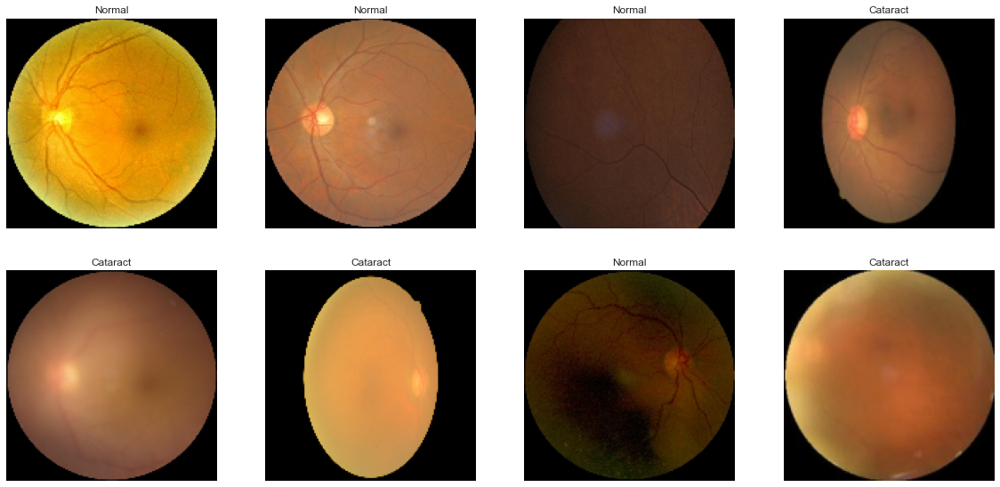

In [26]:
"""
Menampilkan gambar-gambar dari kedua label gambar yaitu gambar mata dengan penyakit katarak dan gambar mata normal
yang telah diinisialisasikan pada proses pemrosesan data gambar di dalam variabel training_generator dengan
image_dataset_from_directory
"""
plt.figure(figsize=(20, 20))

for images, labels in training_generator.take(1):
    for i in range(8):
        ax = plt.subplot(4, 4, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(label_images_train[labels[i]])
        plt.axis("off")

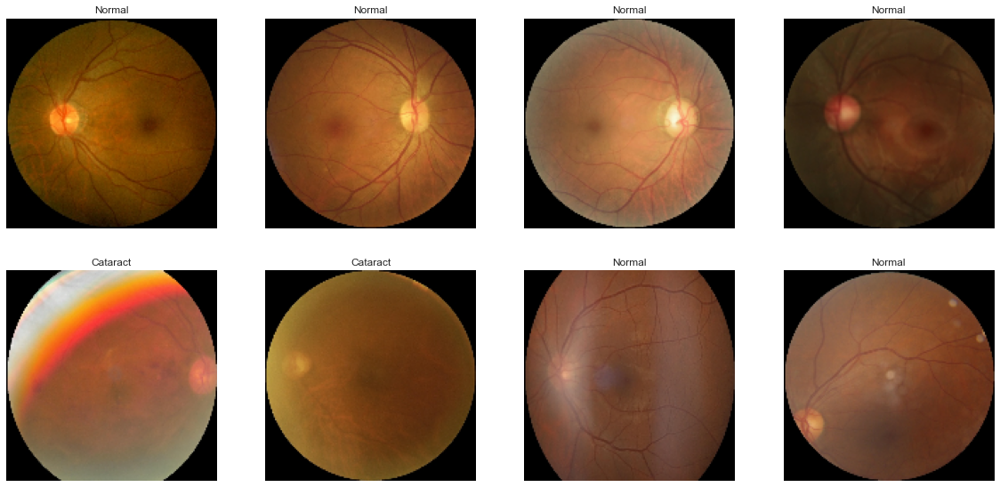

In [27]:
"""
Menampilkan gambar-gambar dari kedua label gambar yaitu gambar mata dengan penyakit katarak dan gambar mata normal
yang telah diinisialisasikan pada proses pemrosesan data gambar di dalam variabel testing_generator dengan
image_dataset_from_directory
"""
plt.figure(figsize=(20, 20))

for images, labels in testing_generator.take(3):    
    for i in range(8):
        ax = plt.subplot(4, 4, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(label_images_test[labels[i]])
        plt.axis("off")

## 4. Modelling with EfficientNetB7 Algorithm + Parameters and Displaying Visualization from Loss, Validation Loss, Accuracy and Validation Accuracy

In [28]:
"""
Membuat neural networks dengan menggunakan algoritma EfficientNetB7 serta menampilkan
hasil dari proses pembuatan neural networks berdasarkan algoritma EfficientNetB7
"""

"""
Menginisialisasikan variabel EfficientNetB7 untuk menampung/menginisialisasi 
metode sequential yang bertujuan untuk mengklasifikasikan urutan gambar dari beberapa label
"""
EfficientNetB7_algorithm = Sequential()

# Memanggil beberapa parameter dari algoritma EfficientNetB7 serta menginisialisasikan nilai dari masing-masing parameter
EfficientNetB7_parameters = EfficientNetB7(
    weights = "imagenet",
    include_top = False,
    classes = 2,
    input_shape = (150, 150, 3),
)

"""
Hyperparameter yang saya gunakan dalam algoritma EfficientNetB7 terdiri dari 4 parameter yang berbeda
yaitu weights, include_top, classes, classifier_activation dan input_shape.
1. weights = "imagenet" bertujuan untuk menjadikan pre-training di ImageNet.
2. include_top bertujuan untuk menyertakan lapisan layer yang terhubung penuh di bagian atas jaringan layer yang akan dibuat.
3. classes merupakan jumlah kelas/kategori pada dataset gambar. Karena pada eksperimen ini hanya
terdapat 2 kelas saja (katarak dan normal), maka nilai dari parameter classes adalah 2
4. input_shape berfungsi untuk dijadikan ukuran dari proses input
dari masing-masing gambar yang akan dilatih oleh algoritma EfficientNetB7.

Referensi: https://keras.io/api/applications/efficientnet/#efficientnetb7-function
"""

# Menginisialisasikan urutan layer untuk algoritma EfficientNetB7
EfficientNetB7_algorithm.add(EfficientNetB7_parameters)
EfficientNetB7_algorithm.add(Dropout(0.5))

EfficientNetB7_algorithm.add(GlobalAveragePooling2D())

EfficientNetB7_algorithm.add(Flatten())
EfficientNetB7_algorithm.add(BatchNormalization())
EfficientNetB7_algorithm.add(Dropout(0.4))

EfficientNetB7_algorithm.add(Dense(152, activation="relu", kernel_regularizer=regularizers.L1(l1=0.01)))

EfficientNetB7_algorithm.add(BatchNormalization())
EfficientNetB7_algorithm.add(Dropout(0.3))

EfficientNetB7_algorithm.add(Dense(48, activation="relu"))
EfficientNetB7_algorithm.add(Dropout(0.3))

EfficientNetB7_algorithm.add(Dense(8, activation="softmax"))

# Memanggil fungsi optimasi Adam beserta nilai learning rate yang akan digunakan oleh algoritma EfficientNetB7
optimizer = Adam(learning_rate=0.001)
 
# Menyusun jaringan yang telah dibuat berdasarkan optimizer yang digunakan
EfficientNetB7_algorithm.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics=["accuracy"])

"""
Menampilkan susunan neural networks yang telah dibuat untuk algoritma EfficientNetB7
yang ditambahkan dengan layer setelah layer EfficientNetB7
"""
EfficientNetB7_algorithm.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnetb7 (Functional)  (None, 5, 5, 2560)       64097687  
                                                                 
 dropout (Dropout)           (None, 5, 5, 2560)        0         
                                                                 
 global_average_pooling2d (G  (None, 2560)             0         
 lobalAveragePooling2D)                                          
                                                                 
 flatten (Flatten)           (None, 2560)              0         
                                                                 
 batch_normalization (BatchN  (None, 2560)             10240     
 ormalization)                                                   
                                                                 
 dropout_1 (Dropout)         (None, 2560)              0

In [29]:
# Menampilkan susunan layer original (layer asli) dari algoritma EfficientNetB7 + parameter-parameter di dalam EfficientNetB7
EfficientNetB7_parameters.summary()

Model: "efficientnetb7"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling (Rescaling)          (None, 150, 150, 3)  0           ['input_1[0][0]']                
                                                                                                  
 normalization (Normalization)  (None, 150, 150, 3)  7           ['rescaling[0][0]']              
                                                                                                  
 rescaling_1 (Rescaling)        (None, 150, 150, 3)  0           ['normalization[0][0

 block1c_activation (Activation  (None, 75, 75, 32)  0           ['block1c_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block1c_se_squeeze (GlobalAver  (None, 32)          0           ['block1c_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block1c_se_reshape (Reshape)   (None, 1, 1, 32)     0           ['block1c_se_squeeze[0][0]']     
                                                                                                  
 block1c_se_reduce (Conv2D)     (None, 1, 1, 8)      264         ['block1c_se_reshape[0][0]']     
                                                                                                  
 block1c_s

 block2a_se_expand (Conv2D)     (None, 1, 1, 192)    1728        ['block2a_se_reduce[0][0]']      
                                                                                                  
 block2a_se_excite (Multiply)   (None, 38, 38, 192)  0           ['block2a_activation[0][0]',     
                                                                  'block2a_se_expand[0][0]']      
                                                                                                  
 block2a_project_conv (Conv2D)  (None, 38, 38, 48)   9216        ['block2a_se_excite[0][0]']      
                                                                                                  
 block2a_project_bn (BatchNorma  (None, 38, 38, 48)  192         ['block2a_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block2b_e

 block2c_drop (Dropout)         (None, 38, 38, 48)   0           ['block2c_project_bn[0][0]']     
                                                                                                  
 block2c_add (Add)              (None, 38, 38, 48)   0           ['block2c_drop[0][0]',           
                                                                  'block2b_add[0][0]']            
                                                                                                  
 block2d_expand_conv (Conv2D)   (None, 38, 38, 288)  13824       ['block2c_add[0][0]']            
                                                                                                  
 block2d_expand_bn (BatchNormal  (None, 38, 38, 288)  1152       ['block2d_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block2d_e

 block2f_expand_conv (Conv2D)   (None, 38, 38, 288)  13824       ['block2e_add[0][0]']            
                                                                                                  
 block2f_expand_bn (BatchNormal  (None, 38, 38, 288)  1152       ['block2f_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block2f_expand_activation (Act  (None, 38, 38, 288)  0          ['block2f_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block2f_dwconv (DepthwiseConv2  (None, 38, 38, 288)  2592       ['block2f_expand_activation[0][0]
 D)                                                              ']                               
          

 block3a_expand_activation (Act  (None, 38, 38, 288)  0          ['block3a_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block3a_dwconv_pad (ZeroPaddin  (None, 41, 41, 288)  0          ['block3a_expand_activation[0][0]
 g2D)                                                            ']                               
                                                                                                  
 block3a_dwconv (DepthwiseConv2  (None, 19, 19, 288)  7200       ['block3a_dwconv_pad[0][0]']     
 D)                                                                                               
                                                                                                  
 block3a_bn (BatchNormalization  (None, 19, 19, 288)  1152       ['block3a_dwconv[0][0]']         
 )        

 )                                                                                                
                                                                                                  
 block3c_activation (Activation  (None, 19, 19, 480)  0          ['block3c_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block3c_se_squeeze (GlobalAver  (None, 480)         0           ['block3c_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block3c_se_reshape (Reshape)   (None, 1, 1, 480)    0           ['block3c_se_squeeze[0][0]']     
                                                                                                  
 block3c_s

 block3e_se_squeeze (GlobalAver  (None, 480)         0           ['block3e_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block3e_se_reshape (Reshape)   (None, 1, 1, 480)    0           ['block3e_se_squeeze[0][0]']     
                                                                                                  
 block3e_se_reduce (Conv2D)     (None, 1, 1, 20)     9620        ['block3e_se_reshape[0][0]']     
                                                                                                  
 block3e_se_expand (Conv2D)     (None, 1, 1, 480)    10080       ['block3e_se_reduce[0][0]']      
                                                                                                  
 block3e_se_excite (Multiply)   (None, 19, 19, 480)  0           ['block3e_activation[0][0]',     
          

 block3g_se_reduce (Conv2D)     (None, 1, 1, 20)     9620        ['block3g_se_reshape[0][0]']     
                                                                                                  
 block3g_se_expand (Conv2D)     (None, 1, 1, 480)    10080       ['block3g_se_reduce[0][0]']      
                                                                                                  
 block3g_se_excite (Multiply)   (None, 19, 19, 480)  0           ['block3g_activation[0][0]',     
                                                                  'block3g_se_expand[0][0]']      
                                                                                                  
 block3g_project_conv (Conv2D)  (None, 19, 19, 80)   38400       ['block3g_se_excite[0][0]']      
                                                                                                  
 block3g_project_bn (BatchNorma  (None, 19, 19, 80)  320         ['block3g_project_conv[0][0]']   
 lization)

 block4b_project_conv (Conv2D)  (None, 10, 10, 160)  153600      ['block4b_se_excite[0][0]']      
                                                                                                  
 block4b_project_bn (BatchNorma  (None, 10, 10, 160)  640        ['block4b_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block4b_drop (Dropout)         (None, 10, 10, 160)  0           ['block4b_project_bn[0][0]']     
                                                                                                  
 block4b_add (Add)              (None, 10, 10, 160)  0           ['block4b_drop[0][0]',           
                                                                  'block4a_project_bn[0][0]']     
                                                                                                  
 block4c_e

 block4d_drop (Dropout)         (None, 10, 10, 160)  0           ['block4d_project_bn[0][0]']     
                                                                                                  
 block4d_add (Add)              (None, 10, 10, 160)  0           ['block4d_drop[0][0]',           
                                                                  'block4c_add[0][0]']            
                                                                                                  
 block4e_expand_conv (Conv2D)   (None, 10, 10, 960)  153600      ['block4d_add[0][0]']            
                                                                                                  
 block4e_expand_bn (BatchNormal  (None, 10, 10, 960)  3840       ['block4e_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block4e_e

 block4g_expand_conv (Conv2D)   (None, 10, 10, 960)  153600      ['block4f_add[0][0]']            
                                                                                                  
 block4g_expand_bn (BatchNormal  (None, 10, 10, 960)  3840       ['block4g_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block4g_expand_activation (Act  (None, 10, 10, 960)  0          ['block4g_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block4g_dwconv (DepthwiseConv2  (None, 10, 10, 960)  8640       ['block4g_expand_activation[0][0]
 D)                                                              ']                               
          

 block4i_expand_activation (Act  (None, 10, 10, 960)  0          ['block4i_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block4i_dwconv (DepthwiseConv2  (None, 10, 10, 960)  8640       ['block4i_expand_activation[0][0]
 D)                                                              ']                               
                                                                                                  
 block4i_bn (BatchNormalization  (None, 10, 10, 960)  3840       ['block4i_dwconv[0][0]']         
 )                                                                                                
                                                                                                  
 block4i_activation (Activation  (None, 10, 10, 960)  0          ['block4i_bn[0][0]']             
 )        

                                                                                                  
 block5a_bn (BatchNormalization  (None, 10, 10, 960)  3840       ['block5a_dwconv[0][0]']         
 )                                                                                                
                                                                                                  
 block5a_activation (Activation  (None, 10, 10, 960)  0          ['block5a_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block5a_se_squeeze (GlobalAver  (None, 960)         0           ['block5a_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block5a_s

 agePooling2D)                                                                                    
                                                                                                  
 block5c_se_reshape (Reshape)   (None, 1, 1, 1344)   0           ['block5c_se_squeeze[0][0]']     
                                                                                                  
 block5c_se_reduce (Conv2D)     (None, 1, 1, 56)     75320       ['block5c_se_reshape[0][0]']     
                                                                                                  
 block5c_se_expand (Conv2D)     (None, 1, 1, 1344)   76608       ['block5c_se_reduce[0][0]']      
                                                                                                  
 block5c_se_excite (Multiply)   (None, 10, 10, 1344  0           ['block5c_activation[0][0]',     
                                )                                 'block5c_se_expand[0][0]']      
          

                                                                                                  
 block5e_se_reduce (Conv2D)     (None, 1, 1, 56)     75320       ['block5e_se_reshape[0][0]']     
                                                                                                  
 block5e_se_expand (Conv2D)     (None, 1, 1, 1344)   76608       ['block5e_se_reduce[0][0]']      
                                                                                                  
 block5e_se_excite (Multiply)   (None, 10, 10, 1344  0           ['block5e_activation[0][0]',     
                                )                                 'block5e_se_expand[0][0]']      
                                                                                                  
 block5e_project_conv (Conv2D)  (None, 10, 10, 224)  301056      ['block5e_se_excite[0][0]']      
                                                                                                  
 block5e_p

 block5g_se_expand (Conv2D)     (None, 1, 1, 1344)   76608       ['block5g_se_reduce[0][0]']      
                                                                                                  
 block5g_se_excite (Multiply)   (None, 10, 10, 1344  0           ['block5g_activation[0][0]',     
                                )                                 'block5g_se_expand[0][0]']      
                                                                                                  
 block5g_project_conv (Conv2D)  (None, 10, 10, 224)  301056      ['block5g_se_excite[0][0]']      
                                                                                                  
 block5g_project_bn (BatchNorma  (None, 10, 10, 224)  896        ['block5g_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block5g_d

                                )                                 'block5i_se_expand[0][0]']      
                                                                                                  
 block5i_project_conv (Conv2D)  (None, 10, 10, 224)  301056      ['block5i_se_excite[0][0]']      
                                                                                                  
 block5i_project_bn (BatchNorma  (None, 10, 10, 224)  896        ['block5i_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block5i_drop (Dropout)         (None, 10, 10, 224)  0           ['block5i_project_bn[0][0]']     
                                                                                                  
 block5i_add (Add)              (None, 10, 10, 224)  0           ['block5i_drop[0][0]',           
          

                                                                  'block6a_se_expand[0][0]']      
                                                                                                  
 block6a_project_conv (Conv2D)  (None, 5, 5, 384)    516096      ['block6a_se_excite[0][0]']      
                                                                                                  
 block6a_project_bn (BatchNorma  (None, 5, 5, 384)   1536        ['block6a_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block6b_expand_conv (Conv2D)   (None, 5, 5, 2304)   884736      ['block6a_project_bn[0][0]']     
                                                                                                  
 block6b_expand_bn (BatchNormal  (None, 5, 5, 2304)  9216        ['block6b_expand_conv[0][0]']    
 ization) 

                                                                  'block6b_add[0][0]']            
                                                                                                  
 block6d_expand_conv (Conv2D)   (None, 5, 5, 2304)   884736      ['block6c_add[0][0]']            
                                                                                                  
 block6d_expand_bn (BatchNormal  (None, 5, 5, 2304)  9216        ['block6d_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block6d_expand_activation (Act  (None, 5, 5, 2304)  0           ['block6d_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block6d_d

 ization)                                                                                         
                                                                                                  
 block6f_expand_activation (Act  (None, 5, 5, 2304)  0           ['block6f_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block6f_dwconv (DepthwiseConv2  (None, 5, 5, 2304)  57600       ['block6f_expand_activation[0][0]
 D)                                                              ']                               
                                                                                                  
 block6f_bn (BatchNormalization  (None, 5, 5, 2304)  9216        ['block6f_dwconv[0][0]']         
 )                                                                                                
          

 block6h_dwconv (DepthwiseConv2  (None, 5, 5, 2304)  57600       ['block6h_expand_activation[0][0]
 D)                                                              ']                               
                                                                                                  
 block6h_bn (BatchNormalization  (None, 5, 5, 2304)  9216        ['block6h_dwconv[0][0]']         
 )                                                                                                
                                                                                                  
 block6h_activation (Activation  (None, 5, 5, 2304)  0           ['block6h_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block6h_se_squeeze (GlobalAver  (None, 2304)        0           ['block6h_activation[0][0]']     
 agePoolin

                                                                                                  
 block6j_activation (Activation  (None, 5, 5, 2304)  0           ['block6j_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block6j_se_squeeze (GlobalAver  (None, 2304)        0           ['block6j_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block6j_se_reshape (Reshape)   (None, 1, 1, 2304)   0           ['block6j_se_squeeze[0][0]']     
                                                                                                  
 block6j_se_reduce (Conv2D)     (None, 1, 1, 96)     221280      ['block6j_se_reshape[0][0]']     
          

 agePooling2D)                                                                                    
                                                                                                  
 block6l_se_reshape (Reshape)   (None, 1, 1, 2304)   0           ['block6l_se_squeeze[0][0]']     
                                                                                                  
 block6l_se_reduce (Conv2D)     (None, 1, 1, 96)     221280      ['block6l_se_reshape[0][0]']     
                                                                                                  
 block6l_se_expand (Conv2D)     (None, 1, 1, 2304)   223488      ['block6l_se_reduce[0][0]']      
                                                                                                  
 block6l_se_excite (Multiply)   (None, 5, 5, 2304)   0           ['block6l_activation[0][0]',     
                                                                  'block6l_se_expand[0][0]']      
          

                                                                                                  
 block7a_se_expand (Conv2D)     (None, 1, 1, 2304)   223488      ['block7a_se_reduce[0][0]']      
                                                                                                  
 block7a_se_excite (Multiply)   (None, 5, 5, 2304)   0           ['block7a_activation[0][0]',     
                                                                  'block7a_se_expand[0][0]']      
                                                                                                  
 block7a_project_conv (Conv2D)  (None, 5, 5, 640)    1474560     ['block7a_se_excite[0][0]']      
                                                                                                  
 block7a_project_bn (BatchNorma  (None, 5, 5, 640)   2560        ['block7a_project_conv[0][0]']   
 lization)                                                                                        
          

                                                                                                  
 block7c_drop (Dropout)         (None, 5, 5, 640)    0           ['block7c_project_bn[0][0]']     
                                                                                                  
 block7c_add (Add)              (None, 5, 5, 640)    0           ['block7c_drop[0][0]',           
                                                                  'block7b_add[0][0]']            
                                                                                                  
 block7d_expand_conv (Conv2D)   (None, 5, 5, 3840)   2457600     ['block7c_add[0][0]']            
                                                                                                  
 block7d_expand_bn (BatchNormal  (None, 5, 5, 3840)  15360       ['block7d_expand_conv[0][0]']    
 ization)                                                                                         
          

In [30]:
# Menampilkan hasil pelatihan dan pengujian dari algoritma EfficientNetB7 dengan 20 kali iterasi (menggunakan fungsi epochs)
result_with_parameters = EfficientNetB7_algorithm.fit(training_generator, validation_data = testing_generator,
                                                      epochs=20, batch_size=8)

Epoch 1/20
185/185 [==============================] - 1734s 9s/step - loss: 27.9139 - accuracy: 0.8168 - val_loss: 6.5774 - val_accuracy: 0.9226
Epoch 2/20
185/185 [==============================] - 1658s 9s/step - loss: 5.8335 - accuracy: 0.8648 - val_loss: 5.6921 - val_accuracy: 0.9305
Epoch 3/20
185/185 [==============================] - 1653s 9s/step - loss: 6.6074 - accuracy: 0.8729 - val_loss: 7.8851 - val_accuracy: 0.5956
Epoch 4/20
185/185 [==============================] - 1643s 9s/step - loss: 6.8749 - accuracy: 0.8587 - val_loss: 4.9843 - val_accuracy: 0.9494
Epoch 5/20
185/185 [==============================] - 1702s 9s/step - loss: 4.9116 - accuracy: 0.9168 - val_loss: 5.2478 - val_accuracy: 0.9321
Epoch 6/20
185/185 [==============================] - 1674s 9s/step - loss: 5.4496 - accuracy: 0.8695 - val_loss: 5.9755 - val_accuracy: 0.7314
Epoch 7/20
185/185 [==============================] - 1653s 9s/step - loss: 4.7599 - accuracy: 0.9094 - val_loss: 4.6302 - val_accuracy

### 4.1. Creating Graphs Visualization based on Loss, Val_Loss, Accuracy, and Val_Accuracy from the Results of 25 Epochs on the EfficientNetB7 Algorithm

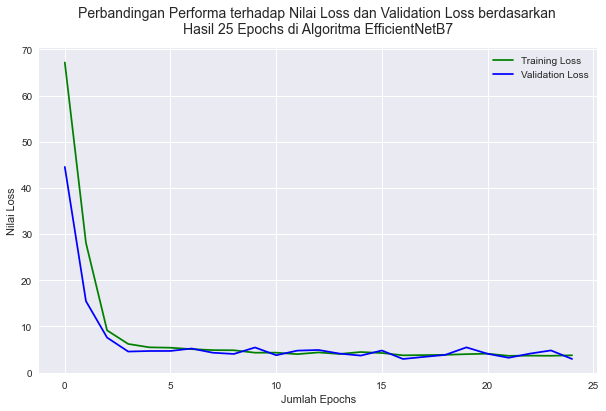

In [33]:
"""
Membuat grafik visualisasi untuk membandingkan nilai dari loss dan validation loss
dari hasil dari proses training dan testing berdasarkan hasil dari 25 epoch di algoritma EfficientNetB7
"""
plt.figure(figsize=(10, 6))

plt.plot(result_with_parameters.history["loss"], color="green", label="Training Loss")
plt.plot(result_with_parameters.history["val_loss"], color="blue", label="Validation Loss")
plt.title("Perbandingan Performa terhadap Nilai Loss dan Validation Loss berdasarkan \n"
          "Hasil 25 Epochs di Algoritma EfficientNetB7", fontsize=14, pad=14)
plt.xlabel("Jumlah Epochs")
plt.ylabel("Nilai Loss")
plt.savefig("Visualization Graphs/Eksperimen-Eksperimen/Grafik Loss dan Validation Loss EfficientNetB7.png")
plt.legend()
plt.show()

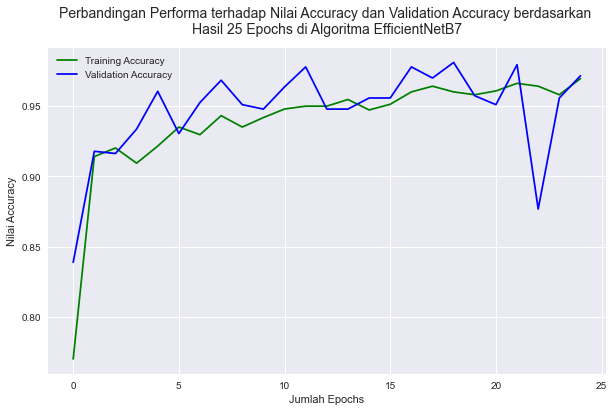

In [34]:
"""
Membuat grafik visualisasi untuk membandingkan nilai dari accuracy dan validation accuracy
dari hasil dari proses training dan testing berdasarkan hasil dari 25 epoch di algoritma EfficientNetB7
"""
plt.figure(figsize=(10, 6))

plt.plot(result_with_parameters.history["accuracy"], color="green", label="Training Accuracy")
plt.plot(result_with_parameters.history["val_accuracy"], color="blue", label="Validation Accuracy")
plt.title("Perbandingan Performa terhadap Nilai Accuracy dan Validation Accuracy berdasarkan \n"
          "Hasil 25 Epochs di Algoritma EfficientNetB7", fontsize=14, pad=14)
plt.xlabel("Jumlah Epochs")
plt.ylabel("Nilai Accuracy")
plt.savefig("Visualization Graphs/Eksperimen-Eksperimen/Grafik Accuracy dan Validation Accuracy EfficientNetB7.png")
plt.legend()
plt.show()

## 5. Creating a Prediction based after Modelling with EfficientNetB7 based on Labels of Dataset (Cataract and Normal)

Di dalam tahap membuat prediksi dari hasil pemodelan deep learning dengan algoritma EfficientNetB7 dengan menggunakan data gambar mata dari kedua kelas/kategori/label diantaranya gambar mata katarak dan gambar mata normal maka didapatkan kesimpulan bahwa algoritma ini sangat cocok digunakan untuk memprediksi dan mengklasifikasikan data gambar berdasarkan kedua label gambar  yaitu katarak dan normal. Untuk memastikan kembali apakah hasil prediksi/klasifikasi gambar telah sesuai/belum maka saya akan membuat proses prediksi menggunakan codingan dimana gambar dapat dikenali dan dicocokkan dari hasil pelatihan dari EfficientNetB7 yang sebelumnya telah dilakukan pelatihan dengan data training (training generator) sekaligus menguji data gambar dengan testing generator. Training dan testing generator dapat dilihat di bagian Image Data Processing

Kedua label/kategori gambar masing-masing akan memiliki sampel sebanyak 15 bagian dalam memprediksi gambar. Jadi gambar mata katarak akan memiliki sampel prediksi sebanyak 15 gambar dengan script serta gambar mata normal juga akan memiliki sampel prediksi sebanyak 15 gambar dengan script. Hal ini dilakukan untuk memastikan apakah EfficientNetB7 sudah tepat dalam memprediksi gambar berdasarkan label gambarnya itu sendiri dengan berdasarkan 15 sampel.

### 5.1. Prediction with Images Data from Cataract Label

#### 5.1.1. Prediction with Cataract Eye Image on the 21 Index

In [135]:
"""
Memanggil salah satu gambar mata dari label katarak untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label katarak yang memiliki indeks ke-21
image_prediction21_cataract = cv2.imread(str(cataract_images[20]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction21_cataract, (150, 150))

image_prediction21 = np.expand_dims(image_shape, axis=0)

print(image_prediction21.shape)

(1, 150, 150, 3)


In [136]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata katarak
"""
prediction_cataract21 = EfficientNetB7_algorithm.predict(image_prediction21)
print(prediction_cataract21)

1/1 [==============================] - 1s 671ms/step
[[9.7787374e-01 2.0886457e-02 3.0245987e-04 2.4514066e-04 1.1877109e-04
  1.1078298e-04 8.8297536e-05 3.7427750e-04]]


In [137]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_cataract_image21 = label_images_test[np.argmax(prediction_cataract21)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_cataract_image21)

Hasil Prediksi berdasarkan Label Gambar ini adalah Cataract


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "cataract_images" dengan indeks/urutan gambar ke-21 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Cataract.

#### 5.1.2. Prediction with Cataract Eye Image on the 7 Index

In [138]:
"""
Memanggil salah satu gambar mata dari label katarak untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label katarak yang memiliki indeks ke-7
image_prediction7_cataract = cv2.imread(str(cataract_images[6]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction7_cataract, (150, 150))

image_prediction7 = np.expand_dims(image_shape, axis=0)

print(image_prediction7.shape)

(1, 150, 150, 3)


In [139]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata katarak
"""
prediction_cataract7 = EfficientNetB7_algorithm.predict(image_prediction7)
print(prediction_cataract7)

1/1 [==============================] - 0s 324ms/step
[[6.8684602e-01 3.0737463e-01 3.8054030e-04 1.2387894e-03 3.0960242e-04
  7.9107337e-04 8.3785004e-04 2.2215089e-03]]


In [140]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_cataract_image7 = label_images_test[np.argmax(prediction_cataract7)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_cataract_image7)

Hasil Prediksi berdasarkan Label Gambar ini adalah Cataract


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "cataract_images" dengan indeks/urutan gambar ke-7 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Cataract.

#### 5.1.3. Prediction with Cataract Eye Image on the 189 Index

In [143]:
"""
Memanggil salah satu gambar mata dari label katarak untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label katarak yang memiliki indeks ke-189
image_prediction189_cataract = cv2.imread(str(cataract_images[188]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction189_cataract, (150, 150))

image_prediction189 = np.expand_dims(image_shape, axis=0)

print(image_prediction189.shape)

(1, 150, 150, 3)


In [144]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata katarak
"""
prediction_cataract189 = EfficientNetB7_algorithm.predict(image_prediction189)
print(prediction_cataract189)

1/1 [==============================] - 0s 309ms/step
[[9.8004395e-01 1.9017471e-02 2.1362300e-04 2.0186146e-04 1.8319114e-04
  7.6207187e-05 1.0653413e-04 1.5721691e-04]]


In [145]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_cataract_image189 = label_images_test[np.argmax(prediction_cataract189)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_cataract_image189)

Hasil Prediksi berdasarkan Label Gambar ini adalah Cataract


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "cataract_images" dengan indeks/urutan gambar ke-189 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Cataract.

#### 5.1.4. Prediction with Cataract Eye Image on the 278 Index

In [146]:
"""
Memanggil salah satu gambar mata dari label katarak untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label katarak yang memiliki indeks ke-278
image_prediction278_cataract = cv2.imread(str(cataract_images[277]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction278_cataract, (150, 150))

image_prediction278 = np.expand_dims(image_shape, axis=0)

print(image_prediction278.shape)

(1, 150, 150, 3)


In [147]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata katarak
"""
prediction_cataract278 = EfficientNetB7_algorithm.predict(image_prediction278)
print(prediction_cataract278)

1/1 [==============================] - 0s 319ms/step
[[9.4944364e-01 4.8796490e-02 2.4802072e-04 2.4964433e-04 1.6548912e-04
  1.9111767e-04 1.5367049e-04 7.5192453e-04]]


In [148]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_cataract_image278 = label_images_test[np.argmax(prediction_cataract278)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_cataract_image278)

Hasil Prediksi berdasarkan Label Gambar ini adalah Cataract


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "cataract_images" dengan indeks/urutan gambar ke-278 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Cataract.

#### 5.1.5. Prediction with Cataract Eye Image on the 143 Index

In [149]:
"""
Memanggil salah satu gambar mata dari label katarak untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label katarak yang memiliki indeks ke-143
image_prediction143_cataract = cv2.imread(str(cataract_images[142]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction143_cataract, (150, 150))

image_prediction143 = np.expand_dims(image_shape, axis=0)

print(image_prediction143.shape)

(1, 150, 150, 3)


In [150]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata katarak
"""
prediction_cataract143 = EfficientNetB7_algorithm.predict(image_prediction143)
print(prediction_cataract143)

1/1 [==============================] - 0s 322ms/step
[[8.5581744e-01 1.4197829e-01 2.1393955e-04 3.7486717e-04 1.9082949e-04
  2.7005936e-04 2.2645124e-04 9.2814676e-04]]


In [151]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_cataract_image143 = label_images_test[np.argmax(prediction_cataract143)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_cataract_image143)

Hasil Prediksi berdasarkan Label Gambar ini adalah Cataract


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "cataract_images" dengan indeks/urutan gambar ke-143 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Cataract.

#### 5.1.6. Prediction with Cataract Eye Image on the 72 Index

In [152]:
"""
Memanggil salah satu gambar mata dari label katarak untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label katarak yang memiliki indeks ke-72
image_prediction72_cataract = cv2.imread(str(cataract_images[71]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction72_cataract, (150, 150))

image_prediction72 = np.expand_dims(image_shape, axis=0)

print(image_prediction72.shape)

(1, 150, 150, 3)


In [153]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata katarak
"""
prediction_cataract72 = EfficientNetB7_algorithm.predict(image_prediction72)
print(prediction_cataract72)

1/1 [==============================] - 0s 356ms/step
[[9.87273693e-01 1.23841725e-02 5.35449217e-05 7.61999836e-05
  4.43806894e-05 2.85274837e-05 2.83971385e-05 1.11065900e-04]]


In [154]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_cataract_image72 = label_images_test[np.argmax(prediction_cataract72)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_cataract_image72)

Hasil Prediksi berdasarkan Label Gambar ini adalah Cataract


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "cataract_images" dengan indeks/urutan gambar ke-72 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Cataract.

#### 5.1.7. Prediction with Cataract Eye Image on the 876 Index

In [155]:
"""
Memanggil salah satu gambar mata dari label katarak untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label katarak yang memiliki indeks ke-876
image_prediction876_cataract = cv2.imread(str(cataract_images[875]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction876_cataract, (150, 150))

image_prediction876 = np.expand_dims(image_shape, axis=0)

print(image_prediction876.shape)

(1, 150, 150, 3)


In [156]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata katarak
"""
prediction_cataract876 = EfficientNetB7_algorithm.predict(image_prediction876)
print(prediction_cataract876)

1/1 [==============================] - 0s 318ms/step
[[9.9475503e-01 5.0664470e-03 3.8303300e-05 4.8807953e-05 3.0022715e-05
  1.2320968e-05 1.8045070e-05 3.1103322e-05]]


In [157]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_cataract_image876 = label_images_test[np.argmax(prediction_cataract876)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_cataract_image876)

Hasil Prediksi berdasarkan Label Gambar ini adalah Cataract


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "cataract_images" dengan indeks/urutan gambar ke-876 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Cataract.

#### 5.1.8. Prediction with Cataract Eye Image on the 923 Index

In [158]:
"""
Memanggil salah satu gambar mata dari label katarak untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label katarak yang memiliki indeks ke-923
image_prediction923_cataract = cv2.imread(str(cataract_images[922]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction923_cataract, (150, 150))

image_prediction923 = np.expand_dims(image_shape, axis=0)

print(image_prediction923.shape)

(1, 150, 150, 3)


In [159]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata katarak
"""
prediction_cataract923 = EfficientNetB7_algorithm.predict(image_prediction923)
print(prediction_cataract923)

1/1 [==============================] - 0s 313ms/step
[[9.6474385e-01 3.2969829e-02 6.0254324e-04 3.9539518e-04 3.0618382e-04
  2.2235719e-04 4.3742536e-04 3.2236363e-04]]


In [160]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_cataract_image923 = label_images_test[np.argmax(prediction_cataract923)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_cataract_image923)

Hasil Prediksi berdasarkan Label Gambar ini adalah Cataract


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "cataract_images" dengan indeks/urutan gambar ke-923 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Cataract.

#### 5.1.9. Prediction with Cataract Eye Image on the 1.016 Index

In [161]:
"""
Memanggil salah satu gambar mata dari label katarak untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label katarak yang memiliki indeks ke-1.016
image_prediction1016_cataract = cv2.imread(str(cataract_images[1015]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction1016_cataract, (150, 150))

image_prediction1016 = np.expand_dims(image_shape, axis=0)

print(image_prediction1016.shape)

(1, 150, 150, 3)


In [162]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata katarak
"""
prediction_cataract1016 = EfficientNetB7_algorithm.predict(image_prediction1016)
print(prediction_cataract1016)

1/1 [==============================] - 0s 340ms/step
[[9.7392029e-01 2.4665609e-02 2.8866128e-04 3.0666267e-04 1.9130434e-04
  1.1441621e-04 2.5814795e-04 2.5486614e-04]]


In [163]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_cataract_image1016 = label_images_test[np.argmax(prediction_cataract1016)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_cataract_image1016)

Hasil Prediksi berdasarkan Label Gambar ini adalah Cataract


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "cataract_images" dengan indeks/urutan gambar ke-1.016 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Cataract.

#### 5.1.10. Prediction with Cataract Eye Image on the 8 Index

In [164]:
"""
Memanggil salah satu gambar mata dari label katarak untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label katarak yang memiliki indeks ke-8
image_prediction8_cataract = cv2.imread(str(cataract_images[7]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction8_cataract, (150, 150))

image_prediction8 = np.expand_dims(image_shape, axis=0)

print(image_prediction8.shape)

(1, 150, 150, 3)


In [165]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata katarak
"""
prediction_cataract8 = EfficientNetB7_algorithm.predict(image_prediction8)
print(prediction_cataract8)

1/1 [==============================] - 0s 311ms/step
[[9.9681431e-01 3.0985607e-03 1.7479750e-05 2.1284348e-05 1.0291526e-05
  4.5008137e-06 9.8753335e-06 2.3707526e-05]]


In [166]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_cataract_image8 = label_images_test[np.argmax(prediction_cataract8)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_cataract_image8)

Hasil Prediksi berdasarkan Label Gambar ini adalah Cataract


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "cataract_images" dengan indeks/urutan gambar ke-8 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Cataract.

#### 5.1.11. Prediction with Cataract Eye Image on the 1.004 Index

In [167]:
"""
Memanggil salah satu gambar mata dari label katarak untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label katarak yang memiliki indeks ke-1.004
image_prediction1004_cataract = cv2.imread(str(cataract_images[1003]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction1004_cataract, (150, 150))

image_prediction1004 = np.expand_dims(image_shape, axis=0)

print(image_prediction1004.shape)

(1, 150, 150, 3)


In [168]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata katarak
"""
prediction_cataract1004 = EfficientNetB7_algorithm.predict(image_prediction1004)
print(prediction_cataract1004)

1/1 [==============================] - 0s 312ms/step
[[9.9345905e-01 6.3063959e-03 4.9825077e-05 6.2804553e-05 3.7526283e-05
  1.2138930e-05 3.9323757e-05 3.2953161e-05]]


In [169]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_cataract_image1004 = label_images_test[np.argmax(prediction_cataract1004)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_cataract_image1004)

Hasil Prediksi berdasarkan Label Gambar ini adalah Cataract


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "cataract_images" dengan indeks/urutan gambar ke-1.004 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Cataract.

#### 5.1.12. Prediction with Cataract Eye Image on the 1 Index

In [170]:
"""
Memanggil salah satu gambar mata dari label katarak untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label katarak yang memiliki indeks ke-1
image_prediction1_cataract = cv2.imread(str(cataract_images[0]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction1_cataract, (150, 150))

image_prediction1 = np.expand_dims(image_shape, axis=0)

print(image_prediction1.shape)

(1, 150, 150, 3)


In [171]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata katarak
"""
prediction_cataract1 = EfficientNetB7_algorithm.predict(image_prediction1)
print(prediction_cataract1)

1/1 [==============================] - 0s 361ms/step
[[9.80170608e-01 1.90793537e-02 1.10073604e-04 2.00442009e-04
  1.06963584e-04 7.66137746e-05 7.32181288e-05 1.82727803e-04]]


In [172]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_cataract_image1 = label_images_test[np.argmax(prediction_cataract1)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_cataract_image1)

Hasil Prediksi berdasarkan Label Gambar ini adalah Cataract


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "cataract_images" dengan indeks/urutan gambar ke-1 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Cataract.

#### 5.1.13. Prediction with Cataract Eye Image on the 1.038 Index

In [173]:
"""
Memanggil salah satu gambar mata dari label katarak untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label katarak yang memiliki indeks ke-1.038
image_prediction1038_cataract = cv2.imread(str(cataract_images[1037]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction1038_cataract, (150, 150))

image_prediction1038 = np.expand_dims(image_shape, axis=0)

print(image_prediction1038.shape)

(1, 150, 150, 3)


In [174]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata katarak
"""
prediction_cataract1038 = EfficientNetB7_algorithm.predict(image_prediction1038)
print(prediction_cataract1038)

1/1 [==============================] - 0s 368ms/step
[[9.3946952e-01 5.7801094e-02 3.7549867e-04 4.4501759e-04 2.5034390e-04
  3.1207484e-04 3.5508940e-04 9.9146820e-04]]


In [175]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_cataract_image1038 = label_images_test[np.argmax(prediction_cataract1038)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_cataract_image1038)

Hasil Prediksi berdasarkan Label Gambar ini adalah Cataract


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "cataract_images" dengan indeks/urutan gambar ke-1.038 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Cataract.

#### 5.1.14. Prediction with Cataract Eye Image on the 658 Index

In [176]:
"""
Memanggil salah satu gambar mata dari label katarak untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label katarak yang memiliki indeks ke-658
image_prediction658_cataract = cv2.imread(str(cataract_images[657]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction658_cataract, (150, 150))

image_prediction658 = np.expand_dims(image_shape, axis=0)

print(image_prediction658.shape)

(1, 150, 150, 3)


In [177]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata katarak
"""
prediction_cataract658 = EfficientNetB7_algorithm.predict(image_prediction658)
print(prediction_cataract658)

1/1 [==============================] - 0s 319ms/step
[[9.79430199e-01 1.98100545e-02 1.36601171e-04 1.59058778e-04
  1.05713756e-04 6.20027058e-05 1.13244292e-04 1.83150638e-04]]


In [178]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_cataract_image658 = label_images_test[np.argmax(prediction_cataract658)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_cataract_image658)

Hasil Prediksi berdasarkan Label Gambar ini adalah Cataract


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "cataract_images" dengan indeks/urutan gambar ke-658 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Cataract.

#### 5.1.15. Prediction with Cataract Eye Image on the 45 Index

In [179]:
"""
Memanggil salah satu gambar mata dari label katarak untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label katarak yang memiliki indeks ke-45
image_prediction45_cataract = cv2.imread(str(cataract_images[44]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction45_cataract, (150, 150))

image_prediction45 = np.expand_dims(image_shape, axis=0)

print(image_prediction45.shape)

(1, 150, 150, 3)


In [180]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata katarak
"""
prediction_cataract45 = EfficientNetB7_algorithm.predict(image_prediction45)
print(prediction_cataract45)

1/1 [==============================] - 0s 318ms/step
[[9.8349392e-01 1.6061688e-02 7.7255412e-05 8.7711327e-05 9.7504671e-05
  5.6054570e-05 3.6051901e-05 8.9844871e-05]]


In [181]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_cataract_image45 = label_images_test[np.argmax(prediction_cataract45)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_cataract_image45)

Hasil Prediksi berdasarkan Label Gambar ini adalah Cataract


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "cataract_images" dengan indeks/urutan gambar ke-45 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Cataract.

### 5.2. Prediction with Images Data from Normal Label

#### 5.2.1. Prediction with Normal Eye Image on the 39 Index

In [182]:
"""
Memanggil salah satu gambar mata dari label normal untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label normal yang memiliki indeks ke-39
image_prediction39_normal = cv2.imread(str(normal_images[38]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction39_normal, (150, 150))

image_prediction39 = np.expand_dims(image_shape, axis=0)

print(image_prediction39.shape)

(1, 150, 150, 3)


In [183]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata normal
"""
prediction_normal39 = EfficientNetB7_algorithm.predict(image_prediction39)
print(prediction_normal39)

1/1 [==============================] - 0s 312ms/step
[[6.4073630e-02 9.3501431e-01 2.9846738e-05 2.9438440e-04 8.4142732e-05
  1.7955825e-04 1.1440247e-04 2.0979157e-04]]


In [184]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_normal_image39 = label_images_test[np.argmax(prediction_normal39)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_normal_image39)

Hasil Prediksi berdasarkan Label Gambar ini adalah Normal


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_images" dengan indeks/urutan gambar ke-39 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Normal.

#### 5.2.2. Prediction with Normal Eye Image on the 4 Index

In [185]:
"""
Memanggil salah satu gambar mata dari label normal untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label normal yang memiliki indeks ke-4
image_prediction4_normal = cv2.imread(str(normal_images[3]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction4_normal, (150, 150))

image_prediction4 = np.expand_dims(image_shape, axis=0)

print(image_prediction4.shape)

(1, 150, 150, 3)


In [186]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata normal
"""
prediction_normal4 = EfficientNetB7_algorithm.predict(image_prediction4)
print(prediction_normal4)

1/1 [==============================] - 0s 310ms/step
[[1.0314137e-02 9.8963600e-01 3.2560042e-06 1.2237989e-05 6.1626147e-06
  6.8560630e-06 9.0112917e-06 1.2312642e-05]]


In [187]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_normal_image4 = label_images_test[np.argmax(prediction_normal4)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_normal_image4)

Hasil Prediksi berdasarkan Label Gambar ini adalah Normal


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_images" dengan indeks/urutan gambar ke-4 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Normal.

#### 5.2.3. Prediction with Normal Eye Image on the 185 Index

In [188]:
"""
Memanggil salah satu gambar mata dari label normal untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label normal yang memiliki indeks ke-185
image_prediction185_normal = cv2.imread(str(normal_images[184]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction185_normal, (150, 150))

image_prediction185 = np.expand_dims(image_shape, axis=0)

print(image_prediction185.shape)

(1, 150, 150, 3)


In [189]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata normal
"""
prediction_normal185 = EfficientNetB7_algorithm.predict(image_prediction185)
print(prediction_normal185)

1/1 [==============================] - 0s 302ms/step
[[8.4709652e-02 9.1452056e-01 3.1639483e-05 2.1115762e-04 3.3168519e-05
  1.0319914e-04 9.1498019e-05 2.9902128e-04]]


In [190]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_normal_image185 = label_images_test[np.argmax(prediction_normal185)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_normal_image185)

Hasil Prediksi berdasarkan Label Gambar ini adalah Normal


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_images" dengan indeks/urutan gambar ke-185 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Normal.

#### 5.2.4. Prediction with Normal Eye Image on the 179 Index

In [191]:
"""
Memanggil salah satu gambar mata dari label normal untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label normal yang memiliki indeks ke-179
image_prediction179_normal = cv2.imread(str(normal_images[178]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction179_normal, (150, 150))

image_prediction179 = np.expand_dims(image_shape, axis=0)

print(image_prediction179.shape)

(1, 150, 150, 3)


In [192]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata normal
"""
prediction_normal179 = EfficientNetB7_algorithm.predict(image_prediction179)
print(prediction_normal179)

1/1 [==============================] - 0s 308ms/step
[[2.8306723e-02 9.7150862e-01 9.6804997e-06 5.9202721e-05 1.5488955e-05
  3.5163972e-05 2.2840492e-05 4.2301603e-05]]


In [193]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_normal_image179 = label_images_test[np.argmax(prediction_normal179)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_normal_image179)

Hasil Prediksi berdasarkan Label Gambar ini adalah Normal


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_images" dengan indeks/urutan gambar ke-179 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Normal.

#### 5.2.5. Prediction with Normal Eye Image on the 376 Index

In [194]:
"""
Memanggil salah satu gambar mata dari label normal untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label normal yang memiliki indeks ke-376
image_prediction376_normal = cv2.imread(str(normal_images[375]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction376_normal, (150, 150))

image_prediction376 = np.expand_dims(image_shape, axis=0)

print(image_prediction376.shape)

(1, 150, 150, 3)


In [195]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata normal
"""
prediction_normal376 = EfficientNetB7_algorithm.predict(image_prediction376)
print(prediction_normal376)

1/1 [==============================] - 0s 313ms/step
[[9.4729150e-03 9.9044001e-01 2.6844853e-06 2.9312885e-05 1.3039458e-05
  1.4021353e-05 1.1748240e-05 1.6305652e-05]]


In [196]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_normal_image376 = label_images_test[np.argmax(prediction_normal376)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_normal_image376)

Hasil Prediksi berdasarkan Label Gambar ini adalah Normal


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_images" dengan indeks/urutan gambar ke-376 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Normal.

#### 5.2.6. Prediction with Normal Eye Image on the 862 Index

In [197]:
"""
Memanggil salah satu gambar mata dari label normal untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label normal yang memiliki indeks ke-862
image_prediction862_normal = cv2.imread(str(normal_images[861]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction862_normal, (150, 150))

image_prediction862 = np.expand_dims(image_shape, axis=0)

print(image_prediction862.shape)

(1, 150, 150, 3)


In [198]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata normal
"""
prediction_normal862 = EfficientNetB7_algorithm.predict(image_prediction862)
print(prediction_normal862)

1/1 [==============================] - 0s 335ms/step
[[3.0899629e-01 6.8591356e-01 2.4984864e-04 1.0914714e-03 3.1568093e-04
  6.9696130e-04 7.7267928e-04 1.9634489e-03]]


In [199]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_normal_image862 = label_images_test[np.argmax(prediction_normal862)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_normal_image862)

Hasil Prediksi berdasarkan Label Gambar ini adalah Normal


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_images" dengan indeks/urutan gambar ke-862 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Normal.

#### 5.2.7. Prediction with Normal Eye Image on the 1.041 Index

In [200]:
"""
Memanggil salah satu gambar mata dari label normal untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label normal yang memiliki indeks ke-1.041
image_prediction1041_normal = cv2.imread(str(normal_images[1040]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction1041_normal, (150, 150))

image_prediction1041 = np.expand_dims(image_shape, axis=0)

print(image_prediction1041.shape)

(1, 150, 150, 3)


In [201]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata normal
"""
prediction_normal1041 = EfficientNetB7_algorithm.predict(image_prediction1041)
print(prediction_normal1041)

1/1 [==============================] - 0s 348ms/step
[[1.08340144e-01 8.90244365e-01 3.81306345e-05 4.39263444e-04
  3.94192248e-05 1.88046935e-04 1.95121174e-04 5.15547174e-04]]


In [202]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_normal_image1041 = label_images_test[np.argmax(prediction_normal1041)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_normal_image1041)

Hasil Prediksi berdasarkan Label Gambar ini adalah Normal


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_images" dengan indeks/urutan gambar ke-1.041 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Normal.

#### 5.2.8. Prediction with Normal Eye Image on the 3 Index

In [203]:
"""
Memanggil salah satu gambar mata dari label normal untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label normal yang memiliki indeks ke-3
image_prediction3_normal = cv2.imread(str(normal_images[2]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction3_normal, (150, 150))

image_prediction3 = np.expand_dims(image_shape, axis=0)

print(image_prediction3.shape)

(1, 150, 150, 3)


In [204]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata normal
"""
prediction_normal3 = EfficientNetB7_algorithm.predict(image_prediction3)
print(prediction_normal3)

1/1 [==============================] - 0s 304ms/step
[[4.3902164e-03 9.9558842e-01 8.8038587e-07 5.1796819e-06 3.8950689e-06
  3.2607741e-06 4.7772655e-06 3.4685409e-06]]


In [205]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_normal_image3 = label_images_test[np.argmax(prediction_normal3)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_normal_image3)

Hasil Prediksi berdasarkan Label Gambar ini adalah Normal


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_images" dengan indeks/urutan gambar ke-3 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Normal.

#### 5.2.9. Prediction with Normal Eye Image on the 836 Index

In [206]:
"""
Memanggil salah satu gambar mata dari label normal untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label normal yang memiliki indeks ke-836
image_prediction836_normal = cv2.imread(str(normal_images[835]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction836_normal, (150, 150))

image_prediction836 = np.expand_dims(image_shape, axis=0)

print(image_prediction836.shape)

(1, 150, 150, 3)


In [207]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata normal
"""
prediction_normal836 = EfficientNetB7_algorithm.predict(image_prediction836)
print(prediction_normal836)

1/1 [==============================] - 0s 319ms/step
[[7.4720588e-03 9.9241650e-01 3.3278500e-06 4.4131208e-05 8.3967243e-06
  1.3240562e-05 7.9782794e-06 3.4336299e-05]]


In [208]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_normal_image836 = label_images_test[np.argmax(prediction_normal836)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_normal_image836)

Hasil Prediksi berdasarkan Label Gambar ini adalah Normal


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_images" dengan indeks/urutan gambar ke-836 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Normal.

#### 5.2.10. Prediction with Normal Eye Image on the 70 Index

In [209]:
"""
Memanggil salah satu gambar mata dari label normal untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label normal yang memiliki indeks ke-70
image_prediction70_normal = cv2.imread(str(normal_images[69]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction70_normal, (150, 150))

image_prediction70 = np.expand_dims(image_shape, axis=0)

print(image_prediction70.shape)

(1, 150, 150, 3)


In [210]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata normal
"""
prediction_normal70 = EfficientNetB7_algorithm.predict(image_prediction70)
print(prediction_normal70)

1/1 [==============================] - 0s 305ms/step
[[2.5828920e-02 9.7385526e-01 1.1531836e-05 9.6596326e-05 5.2601972e-05
  6.7654437e-05 3.3461271e-05 5.4001310e-05]]


In [211]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_normal_image70 = label_images_test[np.argmax(prediction_normal70)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_normal_image70)

Hasil Prediksi berdasarkan Label Gambar ini adalah Normal


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_images" dengan indeks/urutan gambar ke-70 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Normal.

#### 5.2.11. Prediction with Normal Eye Image on the 529 Index

In [212]:
"""
Memanggil salah satu gambar mata dari label normal untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label normal yang memiliki indeks ke-529
image_prediction529_normal = cv2.imread(str(normal_images[528]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction529_normal, (150, 150))

image_prediction529 = np.expand_dims(image_shape, axis=0)

print(image_prediction529.shape)

(1, 150, 150, 3)


In [213]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata normal
"""
prediction_normal529 = EfficientNetB7_algorithm.predict(image_prediction529)
print(prediction_normal529)

1/1 [==============================] - 0s 316ms/step
[[9.3372621e-02 9.0587449e-01 2.9520796e-05 1.8968314e-04 3.4186251e-05
  1.2319292e-04 1.8942825e-04 1.8688169e-04]]


In [214]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_normal_image529 = label_images_test[np.argmax(prediction_normal529)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_normal_image529)

Hasil Prediksi berdasarkan Label Gambar ini adalah Normal


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_images" dengan indeks/urutan gambar ke-529 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Normal.

#### 5.2.12. Prediction with Normal Eye Image on the 1.062 Index

In [215]:
"""
Memanggil salah satu gambar mata dari label normal untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label normal yang memiliki indeks ke-1.062
image_prediction1062_normal = cv2.imread(str(normal_images[1061]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction1062_normal, (150, 150))

image_prediction1062 = np.expand_dims(image_shape, axis=0)

print(image_prediction1062.shape)

(1, 150, 150, 3)


In [216]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata normal
"""
prediction_normal1062 = EfficientNetB7_algorithm.predict(image_prediction1062)
print(prediction_normal1062)

1/1 [==============================] - 0s 309ms/step
[[5.1599945e-04 9.9948210e-01 2.9665934e-08 4.1068171e-07 5.1217165e-07
  1.5220125e-07 6.4954531e-07 1.7873710e-07]]


In [217]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_normal_image1062 = label_images_test[np.argmax(prediction_normal1062)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_normal_image1062)

Hasil Prediksi berdasarkan Label Gambar ini adalah Normal


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_images" dengan indeks/urutan gambar ke-1.062 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Normal.

#### 5.2.13. Prediction with Normal Eye Image on the 1.024 Index

In [218]:
"""
Memanggil salah satu gambar mata dari label normal untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label normal yang memiliki indeks ke-1.024
image_prediction1024_normal = cv2.imread(str(normal_images[1023]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction1024_normal, (150, 150))

image_prediction1024 = np.expand_dims(image_shape, axis=0)

print(image_prediction1024.shape)

(1, 150, 150, 3)


In [219]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata normal
"""
prediction_normal1024 = EfficientNetB7_algorithm.predict(image_prediction1024)
print(prediction_normal1024)

1/1 [==============================] - 0s 325ms/step
[[2.1176066e-03 9.9785322e-01 5.8188544e-07 7.7781870e-06 4.7889957e-06
  4.1940125e-06 5.3673352e-06 6.4861260e-06]]


In [220]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_normal_image1024 = label_images_test[np.argmax(prediction_normal1024)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_normal_image1024)

Hasil Prediksi berdasarkan Label Gambar ini adalah Normal


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_images" dengan indeks/urutan gambar ke-1.024 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Normal.

#### 5.2.14. Prediction with Normal Eye Image on the 1 Index

In [221]:
"""
Memanggil salah satu gambar mata dari label normal untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label normal yang memiliki indeks ke-1
image_prediction1_normal = cv2.imread(str(normal_images[0]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction1_normal, (150, 150))

image_prediction1 = np.expand_dims(image_shape, axis=0)

print(image_prediction1.shape)

(1, 150, 150, 3)


In [222]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata normal
"""
prediction_normal1 = EfficientNetB7_algorithm.predict(image_prediction1)
print(prediction_normal1)

1/1 [==============================] - 0s 311ms/step
[[2.6834938e-03 9.9730140e-01 2.0284584e-07 7.0323827e-06 2.4470996e-06
  1.2412870e-06 1.8879231e-06 2.3796699e-06]]


In [223]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_normal_image1 = label_images_test[np.argmax(prediction_normal1)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_normal_image1)

Hasil Prediksi berdasarkan Label Gambar ini adalah Normal


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_images" dengan indeks/urutan gambar ke-1 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Normal.

#### 5.2.15. Prediction with Normal Eye Image on the 1.074 Index

In [224]:
"""
Memanggil salah satu gambar mata dari label normal untuk dilakukan tahapan prediksi
apakah sudah tepat dalam memprediksi berdasarkan label gambar/belum setelah proses pemodelan dengan EfficientNetB7
"""
# Membaca gambar dengan label normal yang memiliki indeks ke-1.074
image_prediction1074_normal = cv2.imread(str(normal_images[1073]))

# Mengatur dimensi gambar untuk diprediksi dalam satuan lebar (width) & tinggi (height) gambar
image_shape = cv2.resize(image_prediction1074_normal, (150, 150))

image_prediction1074 = np.expand_dims(image_shape, axis=0)

print(image_prediction1074.shape)

(1, 150, 150, 3)


In [225]:
"""
Memanggil algroitma EfficientNetB7 yang telah dilatih dengan data training
serta diujikan kepada data testing untuk dibuat prediksi gambar berdasarkan label gambar mata normal
"""
prediction_normal1074 = EfficientNetB7_algorithm.predict(image_prediction1074)
print(prediction_normal1074)

1/1 [==============================] - 0s 316ms/step
[[2.8793946e-02 9.7092313e-01 8.4368075e-06 8.6724263e-05 2.0856683e-05
  2.4625713e-05 5.4620828e-05 8.7632143e-05]]


In [226]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_label_normal_image1074 = label_images_test[np.argmax(prediction_normal1074)]
print("Hasil Prediksi berdasarkan Label Gambar ini adalah", output_label_normal_image1074)

Hasil Prediksi berdasarkan Label Gambar ini adalah Normal


Berdasarkan hasil prediksi diatas dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_images" dengan indeks/urutan gambar ke-1.074 dapat diklasifikasikan secara tepat oleh algoritma EfficientNetB7 bahwa label gambar berasal dari kelas/label Normal.